# **A hybrid classification model based on clustering: Travel review ratings dataset**
### **In this notebook I will try to do an exploratory data analysis, clustering and finally classification based on clustering for the travel review ratings dataset, found in the UCI machine learning repository.**

<h1 id="Exploratory_Data_Analysis">
1. Exploratory Data Analysis
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#Exploratory_Data_Analysis">¶</a>
</h1>

In [109]:
import numpy as np
import pandas as pd 
import os

            
data = pd.read_csv('/Users/johnmantios1/Desktop/Διπλωματική/travel review ratings/google_review_ratings.csv') 



Let's take a general first idea of our data with info()

In [110]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5456 entries, 0 to 5455
Data columns (total 26 columns):
 #   Column       Dtype  
---  ------       -----  
 0   User         object 
 1   Category 1   float64
 2   Category 2   float64
 3   Category 3   float64
 4   Category 4   float64
 5   Category 5   float64
 6   Category 6   float64
 7   Category 7   float64
 8   Category 8   float64
 9   Category 9   float64
 10  Category 10  float64
 11  Category 11  object 
 12  Category 12  float64
 13  Category 13  float64
 14  Category 14  float64
 15  Category 15  float64
 16  Category 16  float64
 17  Category 17  float64
 18  Category 18  float64
 19  Category 19  float64
 20  Category 20  float64
 21  Category 21  float64
 22  Category 22  float64
 23  Category 23  float64
 24  Category 24  float64
 25  Unnamed: 25  float64
dtypes: float64(24), object(2)
memory usage: 1.1+ MB


We will rename the columns for ease of understanding

In [111]:
column_names = ['user_id', 'churches', 'resorts', 'beaches',
                'parks', 'theatres', 'museums', 'malls', 'zoo',
                'restaurants', 'pubs_bars', 'local_services',
                'burger_pizza_shops', 'hotels_other_lodgings',
                'juice_bars', 'art_galleries', 'dance_clubs',
                 'swimming_pools', 'gyms', 'bakeries', 'beauty_spas',
                'cafes', 'view_points', 'monuments', 'gardens', 'Unnamed: 25']

data.columns = column_names

Let's check how many null values we have

In [112]:
data.isnull().sum()

user_id                     0
churches                    0
resorts                     0
beaches                     0
parks                       0
theatres                    0
museums                     0
malls                       0
zoo                         0
restaurants                 0
pubs_bars                   0
local_services              0
burger_pizza_shops          1
hotels_other_lodgings       0
juice_bars                  0
art_galleries               0
dance_clubs                 0
swimming_pools              0
gyms                        0
bakeries                    0
beauty_spas                 0
cafes                       0
view_points                 0
monuments                   0
gardens                     1
Unnamed: 25              5454
dtype: int64

It seems that we will drop the entire unnamed 25th column and we will impute the 2 rows with zeros supposing that the user did not give any rating to these categories (the 2 null values in category 12 and 24).
Also we will drop the 'User' row as it is of no use to us.Finally, we will map the local_services column from object to float

In [113]:
data.drop('Unnamed: 25', axis = 1, inplace = True)

data.drop('user_id', axis = 1, inplace = True)

data = data.fillna(0)

data['local_services'].astype('float')



ValueError: could not convert string to float: '2\t2.'

So, we have one string in our local_services column.Let's impute it with the column's input_data['local_services'][input_data['local_services']mean

In [114]:
local_services_mean = data['local_services'][data['local_services'] != '2\t2.']

data['local_services'][data['local_services'] == '2\t2.'] = np.mean(local_services_mean.astype('float'))

data['local_services'] = data['local_services'].astype('float')



In [115]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5456 entries, 0 to 5455
Data columns (total 24 columns):
 #   Column                 Dtype  
---  ------                 -----  
 0   churches               float64
 1   resorts                float64
 2   beaches                float64
 3   parks                  float64
 4   theatres               float64
 5   museums                float64
 6   malls                  float64
 7   zoo                    float64
 8   restaurants            float64
 9   pubs_bars              float64
 10  local_services         float64
 11  burger_pizza_shops     float64
 12  hotels_other_lodgings  float64
 13  juice_bars             float64
 14  art_galleries          float64
 15  dance_clubs            float64
 16  swimming_pools         float64
 17  gyms                   float64
 18  bakeries               float64
 19  beauty_spas            float64
 20  cafes                  float64
 21  view_points            float64
 22  monuments              f

Great.All of our data is type 'float'. Let's check some of the descriptive statistics

In [116]:
pd.set_option('display.max_columns', 30)
data.describe()

,churches,resorts,beaches,parks,theatres,museums,malls,zoo,restaurants,pubs_bars,local_services,burger_pizza_shops,hotels_other_lodgings,juice_bars,art_galleries,dance_clubs,swimming_pools,gyms,bakeries,beauty_spas,cafes,view_points,monuments,gardens
count,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.00000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000,5456.000000
mean,1.455720,2.319707,2.489331,2.796886,2.958941,2.89349,3.351395,2.540795,3.126019,2.832729,2.550071,2.077958,2.125511,2.190861,2.206573,1.192801,0.949203,0.822414,0.969811,1.000071,0.965838,1.750537,1.531453,1.560469
std,0.827604,1.421438,1.247815,1.309159,1.339056,1.28240,1.413492,1.111391,1.356802,1.307665,1.381643,1.249411,1.406542,1.576686,1.715961,1.107005,0.973536,0.947911,1.203972,1.193891,0.929853,1.598734,1.316889,1.171840
min,0.000000,0.000000,0.000000,0.830000,1.120000,1.11000,1.120000,0.860000,0.840000,0.810000,0.780000,0.000000,0.770000,0.760000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,0.920000,1.360000,1.540000,1.730000,1.770000,1.79000,1.930000,1.620000,1.800000,1.640000,1.580000,1.290000,1.190000,1.030000,0.860000,0.690000,0.580000,0.530000,0.520000,0.540000,0.570000,0.740000,0.790000,0.880000
50%,1.340000,1.905000,2.060000,2.460000,2.670000,2.68000,3.230000,2.170000,2.800000,2.680000,2.000000,1.690000,1.610000,1.490000,1.330000,0.800000,0.740000,0.690000,0.690000,0.690000,0.760000,1.030000,1.070000,1.290000
75%,1.810000,2.682500,2.740000,4.092500,4.312500,3.84000,5.000000,3.190000,5.000000,3.530000,3.220000,2.282500,2.360000,2.740000,4.440000,1.160000,0.910000,0.840000,0.860000,0.860000,1.000000,2.070000,1.560000,1.660000
max,5.000000,5.000000,5.000000,5.000000,5.000000,5.00000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000,5.000000


Let's visualize our first plot: we will examine the number of reviews under each category

In [117]:
import matplotlib.pyplot as plt
import warnings
%matplotlib inline
import plotly.express as px

# Plotting pretty figures and avoid blurry images
%config InlineBackend.figure_format = 'retina'
# Larger scale for plots in notebooks


# Ignore warnings
import warnings
warnings.filterwarnings('ignore')

# Enable multiple cell outputs
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = 'all'


column_names = ['churches', 'resorts', 'beaches', 'parks', 'theatres', 'museums', 'malls', 'zoo',
                'restaurants', 'pubs_bars', 'local_services',
                'burger_pizza_shops', 'hotels_other_lodgings', 'juice_bars', 
                'art_galleries', 'dance_clubs', 'swimming_pools',
                'gyms', 'bakeries', 'beauty_spas', 'cafes', 'view_points', 'monuments', 'gardens']



counts = data[column_names[:]].astype(bool).sum(axis=0).sort_values()

test = []
for i in range(len(counts.index)):
    test.append(counts.index[i])
    



fig = px.bar(counts, 
             x=counts, 
             y=test,
             color=counts,
                             labels={
                     "total ratings": "this is x",
                     "categories": "this is y)"
                 },
                height = 800,
                title="Number of reviews under each category")

fig.show()



As we can observe, bakeries, gyms and beauty spas are the venues where users show the least amount of interest in rating them.
Let's see how many reviews were given for each category. 


In [118]:
reviews = data[column_names[:]].astype(bool).sum(axis=1).value_counts()


fig = px.bar(reviews, 
             x=reviews.index, 
             y=reviews.values,
             color=reviews.values,
                height = 800,
                title="Number of categories VS Number of reviews")

fig.show()



We can easily understand that a total of 3725 users have given a review for all 24 categories and only 6 gave a review for 15 of all of them. 
Let's check now the average rating for each category

In [119]:
avg_rating = data[column_names[:]].mean().sort_values()



fig = px.bar(avg_rating,
            x = avg_rating.index,
            y = avg_rating.values,
            color = avg_rating.values,
            height = 800,
            title = "Average rating for each category")

fig.show()

We clearly see that gyms are users' least favorite venue with an average rating of 0.82 and on the other hand, malls are the leaders  when it comes to ratings with an average score of 3.35.

Let's analyze the outliers

In [120]:

fig = px.box(data, y = ['churches', 'resorts', 'beaches', 'parks', 'theatres', 'museums', 'malls', 'zoo',
                'restaurants', 'pubs_bars', 'local_services',
                'burger_pizza_shops', 'hotels_other_lodgings', 'juice_bars', 
                'art_galleries', 'dance_clubs', 'swimming_pools',
                'gyms', 'bakeries', 'beauty_spas', 'cafes', 'view_points', 'monuments', 'gardens'] )
fig.show()

In [121]:
df = pd.DataFrame(data)

Q1 = df.quantile(0.25)
Q3 = df.quantile(0.75)
IQR = Q3 - Q1

pd.set_option('display.max_info_rows', 30)

((df < (Q1 - 1.5 * IQR)) | (df > (Q3 + 1.5 * IQR))).sum()



churches                  197
resorts                   966
beaches                   873
parks                       0
theatres                    0
museums                     0
malls                       0
zoo                         0
restaurants                 0
pubs_bars                   0
local_services              0
burger_pizza_shops        827
hotels_other_lodgings     915
juice_bars                  0
art_galleries               0
dance_clubs               501
swimming_pools           1028
gyms                     1573
bakeries                 1771
beauty_spas              1655
cafes                     486
view_points               999
monuments                 718
gardens                   548
dtype: int64

Outliers are expected for large sample sizes. Since the reviews in google do not occur by human mistake , we should not discard them. 

Outlier handling is even more difficult in unsupervised learning, since we are both trying to learn what the clusters are, and what data points correspond to "no" clusters.

<Figure size 1080x720 with 0 Axes>

<AxesSubplot:>

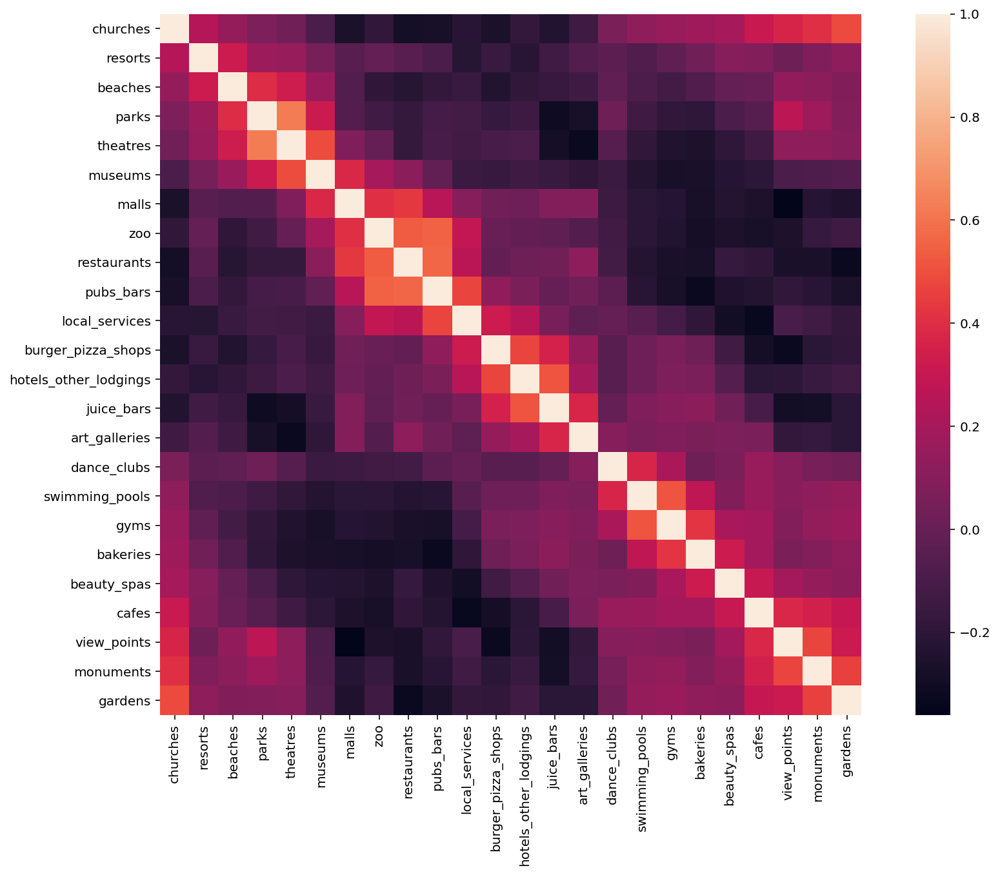

In [122]:
import seaborn as sns

plt.figure(figsize=(15,10))
cor = data.corr() #Calculate the correlation of the above variables
sns.heatmap(cor, square = True) #Plot the correlation as heat map

In [123]:
data.shape

(5456, 24)

In [124]:
data = data.drop_duplicates()

In [125]:
data.shape

(5453, 24)

Not clear at all

It would help us significantly if we would basket the various categories into higher levels, both in terms of analysis and clustering

In [126]:
entertainment = ['theatres', 'dance_clubs', 'malls']
food_travel = ['restaurants', 'pubs_bars', 'burger_pizza_shops', 'juice_bars', 'bakeries', 'cafes']
places_of_stay = ['hotels_other_lodgings', 'resorts']
historical = ['churches', 'museums', 'art_galleries', 'monuments']
nature = ['beaches', 'parks', 'zoo', 'view_points', 'gardens']
services = ['local_services', 'swimming_pools', 'gyms', 'beauty_spas']

In [127]:
df_categories = pd.DataFrame(columns = ['entertainment', 'food_travel', 'places_of_stay', 'historical', 'nature', 'services'])

In [128]:
df_categories['entertainment'] = data[entertainment].mean(axis=1)
df_categories['food_travel'] = data[food_travel].mean(axis = 1)
df_categories['places_of_stay'] = data[places_of_stay].mean(axis = 1)
df_categories['historical'] = data[historical].mean(axis = 1)
df_categories['nature'] = data[nature].mean(axis = 1)
df_categories['services'] = data[services].mean(axis = 1)

In [129]:
df_categories.describe()

,entertainment,food_travel,places_of_stay,historical,nature,services
count,5453.000000,5453.000000,5453.000000,5453.000000,5453.000000,5453.000000
mean,2.500826,2.027232,2.222958,2.022007,2.227858,1.330423
std,0.722012,0.549363,0.886562,0.585001,0.662444,0.580707
min,1.120000,0.721667,0.730000,0.557500,0.576000,0.205000
25%,1.963333,1.650000,1.470000,1.647500,1.762000,0.937500
50%,2.453333,2.028333,1.885000,1.977500,2.160000,1.245000
75%,2.916667,2.433333,3.160000,2.392500,2.656000,1.685000
max,5.000000,3.873333,5.000000,4.322500,4.520000,3.937500


In [130]:

fig = px.box(df_categories, y = ['entertainment', 'food_travel', 'places_of_stay', 'historical', 'nature', 'services'] )
fig.show()

<h1 id="Clustering">
2. Clustering
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#Clustering">¶</a>
</h1>

Let's assess the clusterability of the dataset using the hopkins statistic. According to the pyclustertend library, on a scale from 0 to 1, the lower the score, the better the clusterability of the dataset

In [131]:
from pyclustertend import hopkins 

hopkins(df_categories, df_categories.shape[0])

0.13231460561766104

<h1 id="agglomerative">
2.1 Agglomerative Clustering
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#agglomerative">¶</a>
</h1>

We begin the clustering process with the agglomerative clustering algorithm for one simple reason: it is a hierarchical clustering algorithm, so we simplify the problem of having to choose beforehand the number of clusters in our model.Hierarchical clustering does not avoid the problem with choosing the number of clusters. Simply - it constructs the tree spaning over all samples, which shows which samples (later on - clusters) merge together to create a bigger cluster. This happens recursively till you have just two clusters (this is why the default number of clusters is 2) which are merged to the whole dataset.

Firstly, we are going to determine which linkage method to use. In order to do that we will calculate the cophenet index. Cophenet index is a measure of the correlation between the distance of points in feature space and distance on the dendrogram. If the distance between these points increases as the dendrogram distance between the clusters does then the Cophenet index is closer to 1. So, values closer to 1 mean a better linkage method.

In [132]:
from scipy.cluster.hierarchy import dendrogram
from scipy.cluster import hierarchy
from sklearn.cluster import AgglomerativeClustering
from scipy.spatial.distance import pdist
import plotly.graph_objects as go

Z = hierarchy.linkage(df_categories, 'ward')

c, coph_dists = hierarchy.cophenet(Z, pdist(df_categories, 'hamming'))

ward = c


A = hierarchy.linkage(df_categories,'average')

c, coph_dists = hierarchy.cophenet(A, pdist(df_categories, 'hamming'))

average = c


B = hierarchy.linkage(df_categories,'single')

c, coph_dists = hierarchy.cophenet(B, pdist(df_categories, 'hamming'))

single = c


C = hierarchy.linkage(df_categories,'complete')

c, coph_dists = hierarchy.cophenet(C, pdist(df_categories, 'hamming'))

complete = c


D = hierarchy.linkage(df_categories,'weighted')

c, coph_dists = hierarchy.cophenet(D, pdist(df_categories, 'hamming'))

weighted = c


E = hierarchy.linkage(df_categories,'centroid')

c, coph_dists = hierarchy.cophenet(E, pdist(df_categories, 'hamming'))

centroid = c

F = hierarchy.linkage(df_categories,'median')

c, coph_dists = hierarchy.cophenet(F, pdist(df_categories, 'hamming'))

median = c


metrics=['ward', 'average', 'single', 'complete', 'weighted', 'centroid', 'median']


fig = go.Figure([go.Bar(x=metrics, y=[ward, average, single, complete, weighted, centroid, median])])
fig.show()


We clearly see that the average linkage method is the preferred one.

Let's calculate some useful metrics that will help us decide the number of clusters. Since the ground truth labels are not known we will use such metrics like the silhouette coefficient, the Davies-Bouldin score and the Calinski-Harabasz Index.

In [133]:
from sklearn.metrics import silhouette_score
for n_clusters in range(2,10):
    clusterer = AgglomerativeClustering (n_clusters=n_clusters, distance_threshold = None)
    preds = clusterer.fit_predict(df_categories)
    

    score = silhouette_score (df_categories, preds)
    print ("For n_clusters = {}, silhouette score is {})".format(n_clusters, score))

For n_clusters = 2, silhouette score is 0.22158544351179446)
For n_clusters = 3, silhouette score is 0.20182285443486128)
For n_clusters = 4, silhouette score is 0.189815938721593)
For n_clusters = 5, silhouette score is 0.15812398297216884)
For n_clusters = 6, silhouette score is 0.15199594822754037)
For n_clusters = 7, silhouette score is 0.12926971419455385)
For n_clusters = 8, silhouette score is 0.1355578191952782)
For n_clusters = 9, silhouette score is 0.1431307502041297)


From the various silhouette score we can see that although 2 clusters would be a better choice for our data, the score itself is pretty low

Let's check the Davies-Bouldin score.We want a values as close to 0 as possible

In [134]:
from sklearn.metrics import davies_bouldin_score

for n_clusters in range(2,10):
    clusterer = AgglomerativeClustering (n_clusters=n_clusters, distance_threshold = None)
    preds = clusterer.fit_predict(df_categories)
    
    score = davies_bouldin_score (df_categories , preds)
    print ("For n_clusters = {}, the Davies-Bouldin score is {})".format(n_clusters, score))

For n_clusters = 2, the Davies-Bouldin score is 1.659410598090416)
For n_clusters = 3, the Davies-Bouldin score is 1.7111693839953748)
For n_clusters = 4, the Davies-Bouldin score is 1.6369413453964223)
For n_clusters = 5, the Davies-Bouldin score is 1.467385716618958)
For n_clusters = 6, the Davies-Bouldin score is 1.439559956466035)
For n_clusters = 7, the Davies-Bouldin score is 1.6527684186890113)
For n_clusters = 8, the Davies-Bouldin score is 1.7402484755833423)
For n_clusters = 9, the Davies-Bouldin score is 1.6790780867614137)


Again, 6 clusters have the lowest score from a reasonable range of clusters

Calinski-Harabasz index.We want as high a score as possible

In [135]:
from sklearn.metrics import calinski_harabasz_score

for n_clusters in range(2,10):
    clusterer = AgglomerativeClustering (n_clusters=n_clusters, distance_threshold = None)
    preds = clusterer.fit_predict(df_categories)
    
    score = calinski_harabasz_score(df_categories, preds)
    print ("For n_clusters = {}, the Calinski-Harabasz score is {})".format(n_clusters, score))

For n_clusters = 2, the Calinski-Harabasz score is 1454.9507447097092)
For n_clusters = 3, the Calinski-Harabasz score is 1381.0401232461509)
For n_clusters = 4, the Calinski-Harabasz score is 1215.1868396401599)
For n_clusters = 5, the Calinski-Harabasz score is 1072.6604827258673)
For n_clusters = 6, the Calinski-Harabasz score is 985.3429065325281)
For n_clusters = 7, the Calinski-Harabasz score is 933.752515783)
For n_clusters = 8, the Calinski-Harabasz score is 888.8775814483722)
For n_clusters = 9, the Calinski-Harabasz score is 858.8051559946975)


Here the metric shows that 2 clusters would be better than 3.

<Figure size 1440x720 with 0 Axes>

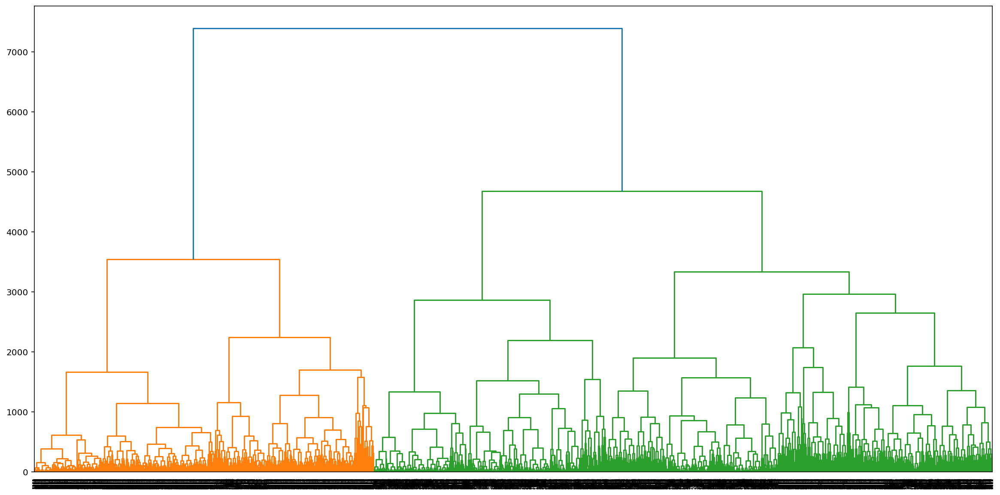

In [136]:
model = AgglomerativeClustering(distance_threshold=0, n_clusters = None)
model = model.fit(df_categories)

Z = hierarchy.linkage(model.children_, 'average')

plt.figure(figsize=(20,10))

dn = hierarchy.dendrogram(Z)

By looking at the above dendrogram, we observe 3 distinct colors in the dendrogram, but this will not determine how many clusters are formed. Following the main criteria of cutting the dendrogram appropriately, we discover that there are basically 5 clusters. Observing the height of each dendrogram division we decided to go with 4000 where the line would be drawn.

Now, let's plot our data using the labels that the algorithm generated.We are going to make a scatterplot.

2    2044
1    1741
0    1668
Name: AggLabels, dtype: int64

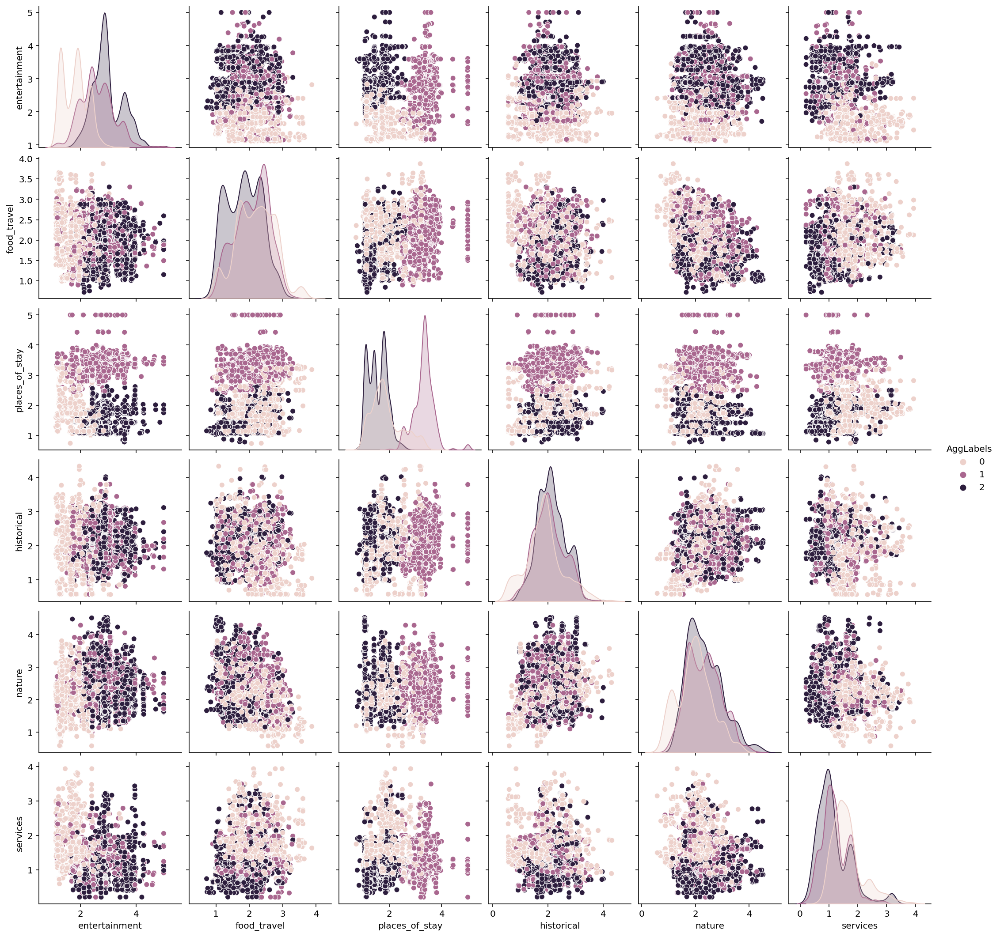

In [137]:
df = pd.DataFrame(data)

model = AgglomerativeClustering(distance_threshold=None, n_clusters = 3)
model = model.fit(df_categories)
y_agg=model.fit_predict(df_categories)

df_agg = df_categories.copy()
df_agg["AggLabels"] = y_agg

#uncomment the following line and let your machine explode!
sns.pairplot( df_agg, hue="AggLabels")  

df_agg["AggLabels"].value_counts(0)




<h1 id="DBSCAN">
2.2 DBSCAN
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#DBSCAN">¶</a>
</h1>

Following, we apply to our data set the DBSCAN algorithm.DBSCAN works by running a connected components algorithm across the different core points. If two core points share border points, or a core point is a border point in another core point’s neighborhood, then they’re part of the same connected component, which forms a cluster.
A low min_samples parameter means it will build more clusters from noise, so we shouldn't choose it too small.
The DBSCAN paper suggests to choose minPts based on the dimensionality, and eps based on the elbow in the k-distance graph.
For eps, we can try to do a knn distance histogram and choose a "knee" there, but there might be no visible one, or multiple.

In the more recent publication

Schubert, E., Sander, J., Ester, M., Kriegel, H. P., & Xu, X. (2017).
DBSCAN Revisited, Revisited: Why and How You Should (Still) Use DBSCAN.
ACM Transactions on Database Systems (TODS), 42(3), 19.


the authors suggest to use a larger minpts for large and noisy data sets, and to adjust epsilon depending on whether you get too large clusters (decrease epsilon) or too much noise (increase epsilon). Clustering requires iterations.

After some trial and error, the min_samples value with the less noise is 43

Let's apply the Knee method using KNN to find the optimal eps value for our model. Since KNN is a supervised learning algorithm and our data is not labeled, we will apply a general rule of thumb popularized by the "Pattern Classification" book by Duda et al., saying that the optimal K value usually found is the square root of N, where N is the total number of samples.

NearestNeighbors(n_neighbors=73)

<Figure size 1440x720 with 0 Axes>

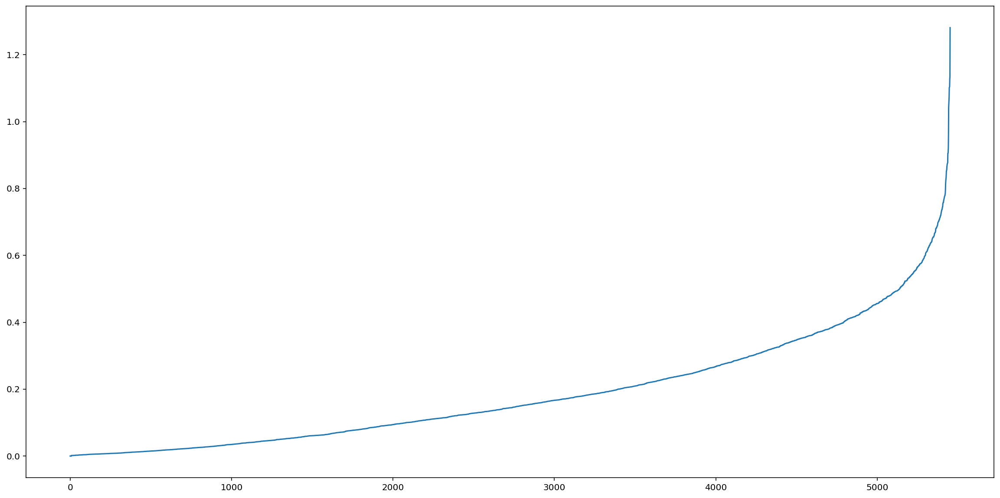

In [138]:
from sklearn.neighbors import NearestNeighbors

nearest_neighbors = NearestNeighbors(n_neighbors=73) #sqrt(5456) = 73
nearest_neighbors.fit(df_categories)
distances, indices = nearest_neighbors.kneighbors(df_categories)
distances = np.sort(distances, axis=0)[:, 1]
#print(distances)
plt.figure(figsize=(20,10))
plt.plot(distances)
plt.show()

Optimal value for eps where a 'knee' is formed is 0.6.

array([-1,  0,  1,  2,  3,  4,  5,  6])

 0    2477
-1    2432
 2     189
 1     135
 5      82
 6      48
 3      47
 4      43
Name: DBLabels, dtype: int64

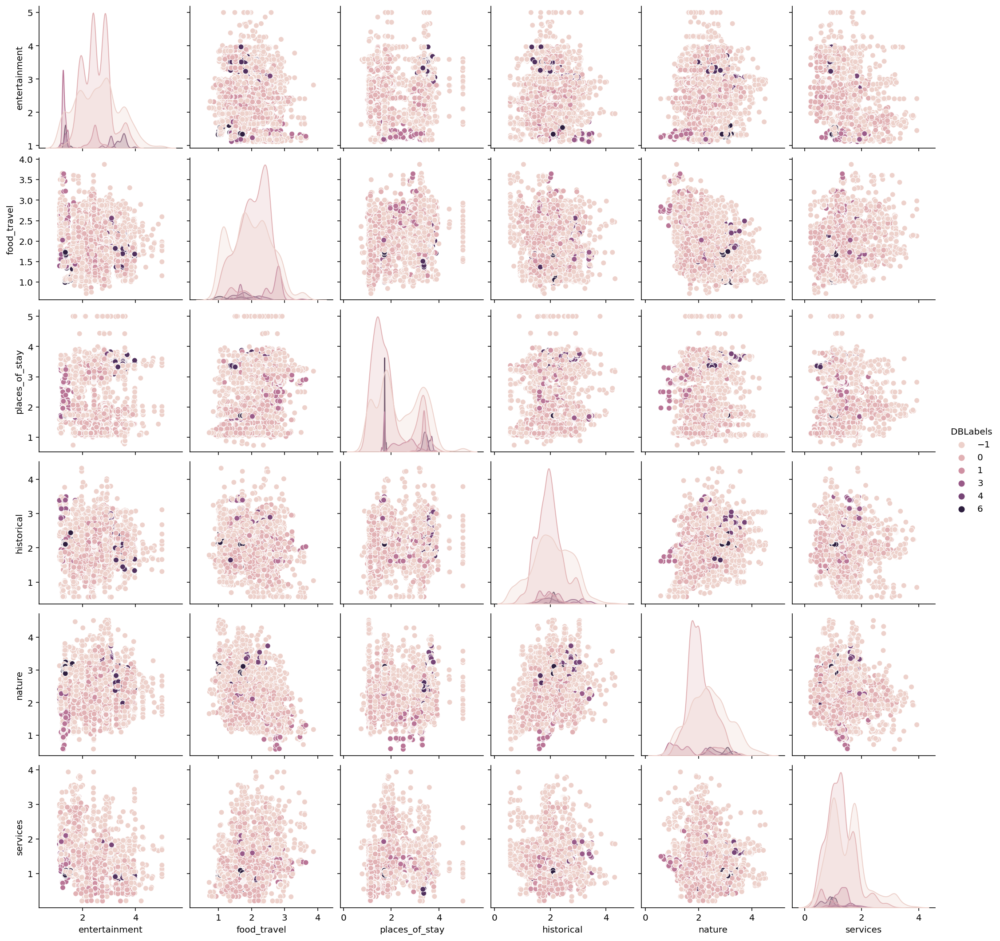

In [139]:
from sklearn.cluster import DBSCAN

model2 = DBSCAN(eps = 0.6, min_samples = 43)

model2 = model2.fit(df_categories)

np.unique(model2.labels_)

y_db=model2.labels_

df_db = df_categories.copy()
df_db["DBLabels"] = y_db

df_db["DBLabels"].value_counts(0)


sns.pairplot( df_db, hue="DBLabels")  




In [140]:
df_db

,entertainment,food_travel,places_of_stay,historical,nature,services,DBLabels
0,3.530000,1.480000,0.850,1.1650,1.926,0.5500,-1
1,3.530000,1.481667,0.850,1.1650,1.984,0.5500,-1
2,3.530000,1.480000,0.850,1.1650,1.980,0.5500,-1
3,3.530000,1.480000,1.100,1.1650,1.922,0.5575,-1
5,3.530000,1.481667,0.845,1.1650,1.978,0.5525,-1
...,...,...,...,...,...,...,...
5451,1.953333,1.150000,3.145,3.3700,2.888,1.8325,-1
5452,1.733333,1.290000,3.135,2.3475,2.794,0.9800,-1
5453,1.726667,1.135000,3.040,2.3450,2.798,1.8150,-1
5454,1.730000,1.126667,2.555,3.3475,2.802,1.8100,-1


Let's remove the noise

In [141]:
# Get names of indexes for which column DB_Labels has value -1
indexNames = df_db[ df_db['DBLabels'] == -1 ].index
# Delete these row indexes from dataFrame
df_db.drop(indexNames , inplace=True)

df_db['DBLabels'].unique()

array([0, 1, 4, 5, 2, 3, 6])

In [142]:
df_db

,entertainment,food_travel,places_of_stay,historical,nature,services,DBLabels
37,2.823333,1.351667,1.080,1.2775,2.432,0.5425,0
40,2.880000,1.268333,1.075,1.4050,1.502,1.3850,0
45,2.490000,1.400000,1.060,1.3150,2.564,0.5325,0
46,2.486667,1.396667,1.060,1.3150,2.420,0.5200,0
48,2.510000,1.393333,1.060,1.8300,2.426,0.5225,0
...,...,...,...,...,...,...,...
5399,1.340000,1.056667,1.720,2.1575,2.960,0.9575,6
5401,1.340000,1.705000,1.715,2.1025,2.902,0.9600,6
5402,1.343333,1.728333,1.715,2.1050,2.888,1.0325,6
5406,2.810000,1.075000,1.780,2.5400,3.024,1.0625,0


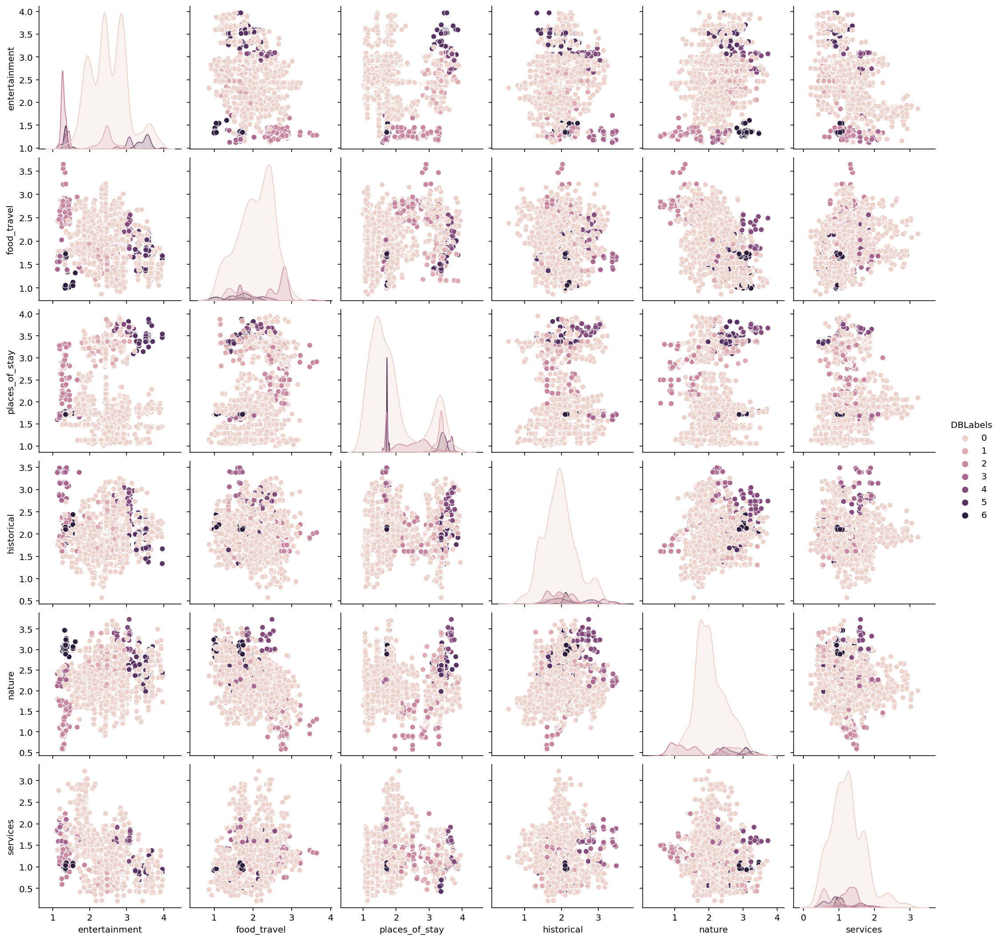

In [143]:
sns.pairplot( df_db, hue="DBLabels")  

In [144]:
y_db = df_db['DBLabels']
silhouette_score (df_db, y_db)

0.3256109482808125

<h1 id="EM">
2.3 EM using GMM
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#EM">¶</a>
</h1>

At its simplest, GMM is also a type of clustering algorithm. As its name implies, each cluster is modelled according to a different Gaussian distribution. This flexible and probabilistic approach to modelling the data means that rather than having hard assignments into clusters like k-means, we have soft assignments. This means that each data point could have been generated by any of the distributions with a corresponding probability.

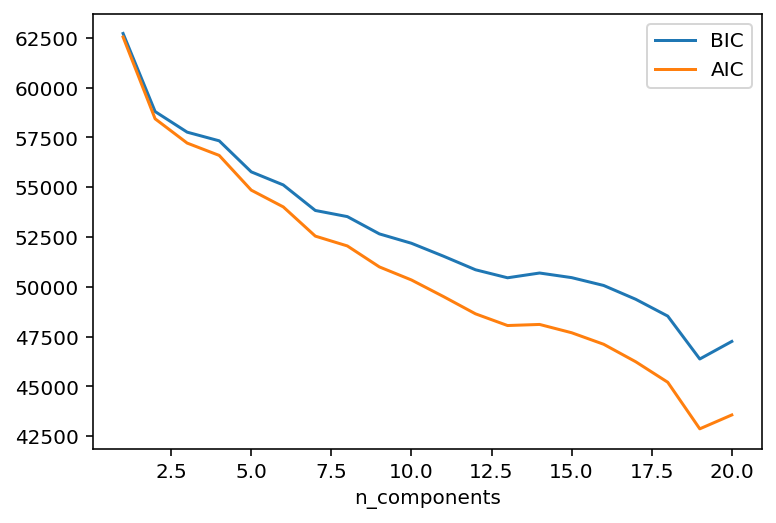

In [145]:
from sklearn.mixture import GaussianMixture as GMM

n_components = np.arange(1, 21)
models = [GMM(n, covariance_type='full', random_state=0).fit(df_categories)
          for n in n_components]

plt.plot(n_components, [m.bic(df_categories) for m in models], label='BIC')
plt.plot(n_components, [m.aic(df_categories) for m in models], label='AIC')
plt.legend(loc='best')
plt.xlabel('n_components');

The choice of number of components measures how well GMM works as a density estimator, not how well it works as a clustering algorithm. From the above plot it shows that optimal number of components is 6 (where the gradient stops decreasing)

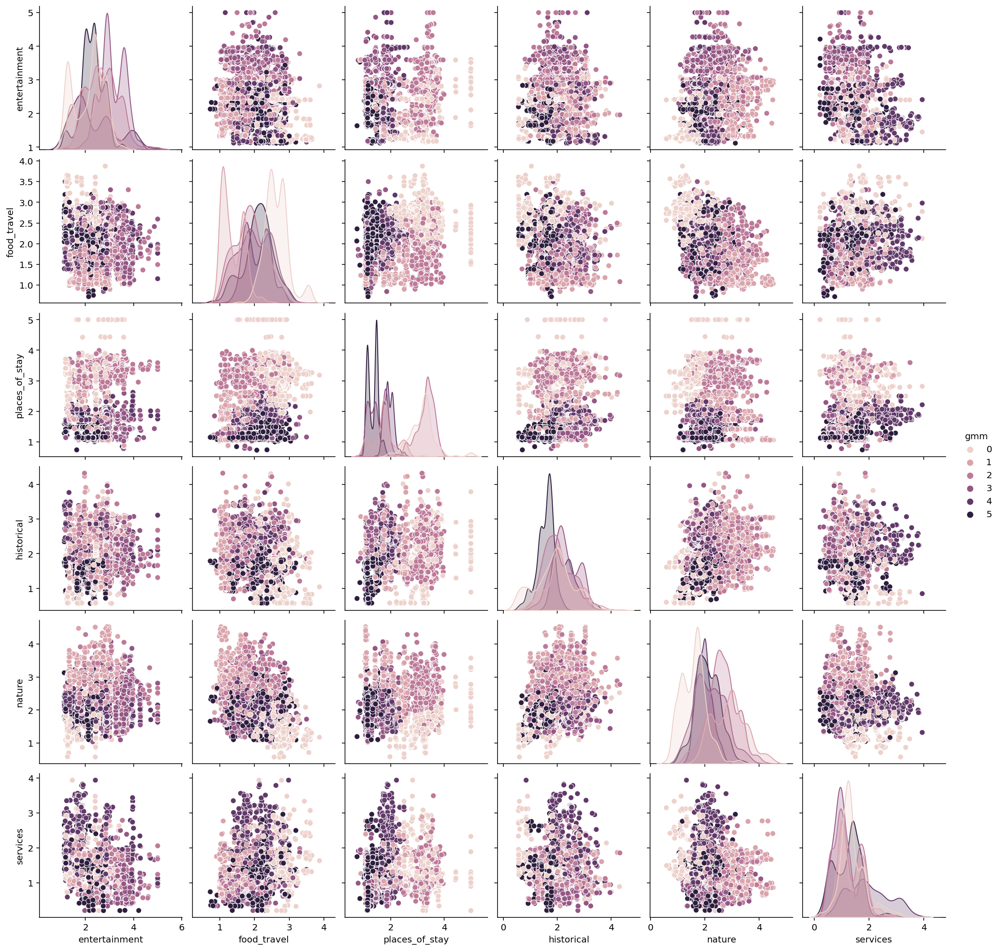

In [146]:
from matplotlib.patches import Ellipse

df_gmm = df_categories.copy()

df_gmm['gmm'] = GMM(n_components=6, random_state=42).fit_predict(df_categories)

sns.pairplot( df_gmm, hue="gmm")  

<h1 id="kmeans">
2.4 KMeans
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#kmeans">¶</a>
</h1>

Kmeans algorithm is an iterative algorithm that tries to partition the dataset into K pre-defined distinct non-overlapping subgroups (clusters) where each data point belongs to only one group
It tries to make the intra-cluster data points as similar as possible while also keeping the clusters as different (far) as possible. It assigns data points to a cluster such that the sum of the squared distance between the data points and the cluster’s centroid (arithmetic mean of all the data points that belong to that cluster) is at the minimum. The less variation we have within clusters, the more homogeneous (similar) the data points are within the same cluster.

In [147]:
from sklearn.cluster import KMeans

for n_clusters in range(2,10):
    clusterer = KMeans(n_clusters = n_clusters)
    preds = clusterer.fit_predict(df_categories)
    

    score = silhouette_score (df_categories, preds)
    print ("For n_clusters = {}, silhouette score is {})".format(n_clusters, score))

For n_clusters = 2, silhouette score is 0.25257516305107913)
For n_clusters = 3, silhouette score is 0.21766067326092503)
For n_clusters = 4, silhouette score is 0.20545597085879697)
For n_clusters = 5, silhouette score is 0.2007210050462427)
For n_clusters = 6, silhouette score is 0.20174862061596927)
For n_clusters = 7, silhouette score is 0.2064020633483701)
For n_clusters = 8, silhouette score is 0.19147016673883316)
For n_clusters = 9, silhouette score is 0.19692041200674745)


KMeans(n_clusters=1)

KMeans(n_clusters=2)

KMeans(n_clusters=3)

KMeans(n_clusters=4)

KMeans(n_clusters=5)

KMeans(n_clusters=6)

KMeans(n_clusters=7)

KMeans()

KMeans(n_clusters=9)

1 : 14869.622478658603
2 : 11193.38860673624
3 : 9481.993214081653
4 : 8367.006952797432
5 : 7589.009501650535
6 : 7035.3011370684735
7 : 6602.491477883675
8 : 6219.463692409938
9 : 5920.363479851499


Text(0.5, 0, 'Values of K')

Text(0, 0.5, 'Inertia')

Text(0.5, 1.0, 'The Elbow Method using Inertia')

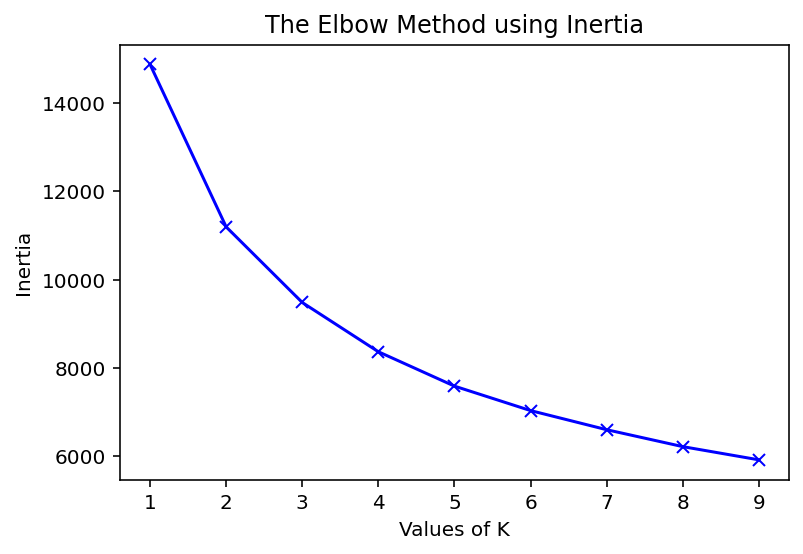

In [148]:
from scipy.spatial.distance import cdist

distortions = [] 
inertias = [] 
mapping1 = {} 
mapping2 = {} 
K = range(1,10) 
  
for k in K: 
    #Building and fitting the model 
    kmeanModel = KMeans(n_clusters=k).fit(df_categories) 
    kmeanModel.fit(df_categories)     
      
    distortions.append(sum(np.min(cdist(df_categories, kmeanModel.cluster_centers_, 
                      'euclidean'),axis=1)) / df_categories.shape[0]) 
    inertias.append(kmeanModel.inertia_) 
  

    mapping2[k] = kmeanModel.inertia_ 
    
for key,val in mapping2.items(): 
    print(str(key)+' : '+str(val))
    
plt.plot(K, inertias, 'bx-') 
plt.xlabel('Values of K') 
plt.ylabel('Inertia') 
plt.title('The Elbow Method using Inertia') 
plt.show()     

We'll go with 2 clusters

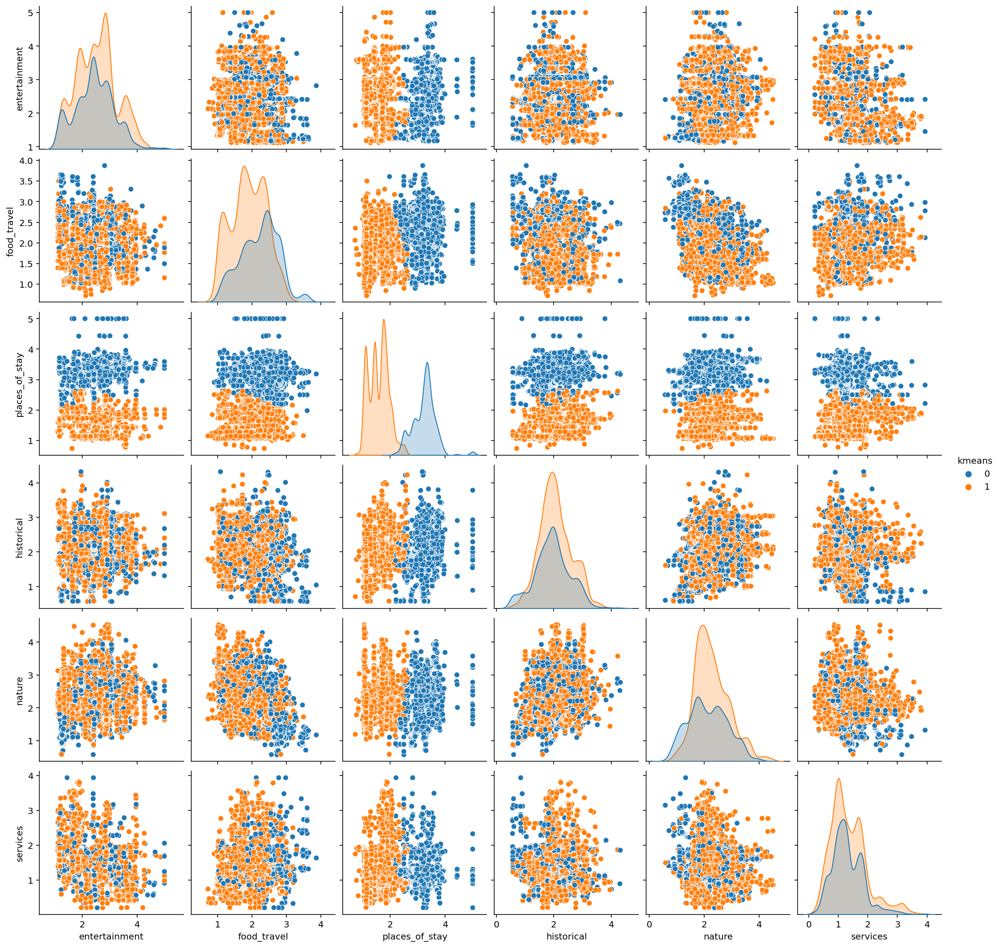

In [149]:
model4 = KMeans(n_clusters = 2, n_init=40)

model4 = model4.fit(df_categories)

df_kmeans = df_categories.copy()

df_kmeans['kmeans'] = model4.fit_predict(df_categories)

sns.pairplot( df_kmeans, hue="kmeans")  


<h1 id="classification">
3 Classification
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#classification">¶</a>
</h1>

<h2 id="Agglomerative_Dataset">
3.1 Agglomerative Dataset
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#Agglomerative_Dataset">¶</a>
</h2>

<h3 id="Decision_Tree">
3.1.1 Decision Tree
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#Decision_Tree">¶</a>
</h3>

In [150]:
df_agg.drop_duplicates()

,entertainment,food_travel,places_of_stay,historical,nature,services,AggLabels
0,3.530000,1.480000,0.850,1.1650,1.926,0.5500,2
1,3.530000,1.481667,0.850,1.1650,1.984,0.5500,2
2,3.530000,1.480000,0.850,1.1650,1.980,0.5500,2
3,3.530000,1.480000,1.100,1.1650,1.922,0.5575,2
5,3.530000,1.481667,0.845,1.1650,1.978,0.5525,2
...,...,...,...,...,...,...,...
5451,1.953333,1.150000,3.145,3.3700,2.888,1.8325,0
5452,1.733333,1.290000,3.135,2.3475,2.794,0.9800,1
5453,1.726667,1.135000,3.040,2.3450,2.798,1.8150,1
5454,1.730000,1.126667,2.555,3.3475,2.802,1.8100,0


In [151]:
for col in df_agg.columns:
    print(df_agg[col].value_counts())

2.373333    118
2.803333     77
2.893333     60
2.430000     57
2.806667     56
           ... 
1.980000      1
2.596667      1
2.206667      1
3.096667      1
4.386667      1
Name: entertainment, Length: 1024, dtype: int64
2.343333    15
1.715000    13
2.360000    13
1.030000    13
1.033333    12
            ..
3.006667     1
2.038333     1
1.581667     1
1.185000     1
1.583333     1
Name: food_travel, Length: 2012, dtype: int64
1.710    91
1.440    75
1.060    69
2.500    63
1.080    62
         ..
2.060     1
1.670     1
1.215     1
2.110     1
1.340     1
Name: places_of_stay, Length: 694, dtype: int64
1.6025    22
2.2150    22
1.6150    21
2.0800    20
1.6100    19
          ..
1.5750     1
3.7725     1
1.6525     1
2.9300     1
3.7850     1
Name: historical, Length: 1592, dtype: int64
1.832    14
1.972    13
2.364    13
2.014    13
1.680    12
         ..
3.620     1
3.348     1
1.860     1
3.026     1
1.124     1
Name: nature, Length: 1962, dtype: int64
1.2500    64
1.2825    4

In [152]:
X = df_agg.drop(['AggLabels'], axis=1)
y = df_agg['AggLabels']

In [153]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state = 42, stratify=y)

In [154]:
print(y_test.value_counts()) #we secured the 20% in the classes represenation

2    409
1    348
0    334
Name: AggLabels, dtype: int64


In [155]:
from imblearn.over_sampling import SMOTE

sm = SMOTE(random_state = 42)
           
X_train, y_train = sm.fit_sample(X_train, y_train) 

In [156]:
y_train.value_counts()

2    1635
1    1635
0    1635
Name: AggLabels, dtype: int64

# GINI CRITERION

In [157]:
from sklearn.metrics import log_loss
from sklearn.tree import DecisionTreeClassifier

training_scores = []
test_scores = []

def tree_scores(i):
    clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=i, random_state = 42)
    
    
    clf_gini.fit(X_train, y_train)
    y_pred_gini = clf_gini.predict_proba(X_test)
    y_pred_train_gini = clf_gini.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))
    training_scores.append(log_loss(y_train, y_pred_train_gini))

    print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))
    test_scores.append(log_loss(y_test, y_pred_gini))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.6585
Test set score: 0.6865
Max Depth: 2
Training set score: 0.8975
Test set score: 0.8836
Max Depth: 3
Training set score: 0.9309
Test set score: 0.9258
Max Depth: 4
Training set score: 0.9419
Test set score: 0.9340
Max Depth: 5
Training set score: 0.9554
Test set score: 0.9588
Max Depth: 6
Training set score: 0.9725
Test set score: 0.9588
Max Depth: 7
Training set score: 0.9817
Test set score: 0.9661
Max Depth: 8
Training set score: 0.9902
Test set score: 0.9707
Max Depth: 9
Training set score: 0.9947
Test set score: 0.9725
Max Depth: 10
Training set score: 0.9971
Test set score: 0.9707


Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

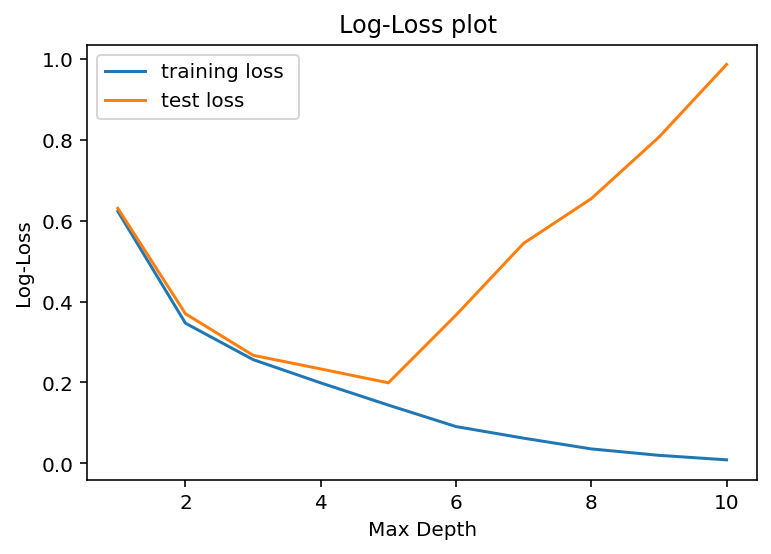

In [158]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_scores, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_scores, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [159]:
from sklearn.model_selection import GridSearchCV

parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='gini', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

GridSearchCV(estimator=DecisionTreeClassifier(random_state=42), n_jobs=4,
             param_grid={'max_depth': range(1, 11)})

0.9694189602446484 {'max_depth': 10}


In [160]:
from sklearn.model_selection import cross_val_score

clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=5, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gini, X_train, y_train, cv=10)))

Cross-Validation Score: 0.9429136705598736


In [161]:
clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=5, random_state = 42)

clf_gini.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=5, random_state=42)

In [162]:
y_pred_gini = clf_gini.predict(X_test)

In [163]:
print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))

Training set score: 0.9554
Test set score: 0.9588


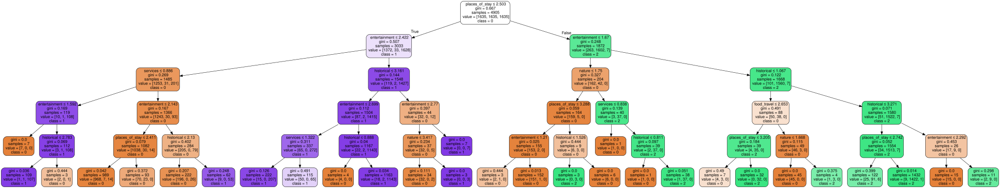

In [164]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import graphviz
from sklearn import tree



dot_data = tree.export_graphviz(clf_gini, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [165]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

cf_matrix = confusion_matrix(y_test, y_pred_gini)

cf_matrix

array([[308,   9,  17],
       [  3, 345,   0],
       [ 11,   5, 393]])

<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '2'), Text(1.5, 0, '1'), Text(2.5, 0, '0')]

[Text(0, 0.5, '2'), Text(0, 1.5, '1'), Text(0, 2.5, '0')]

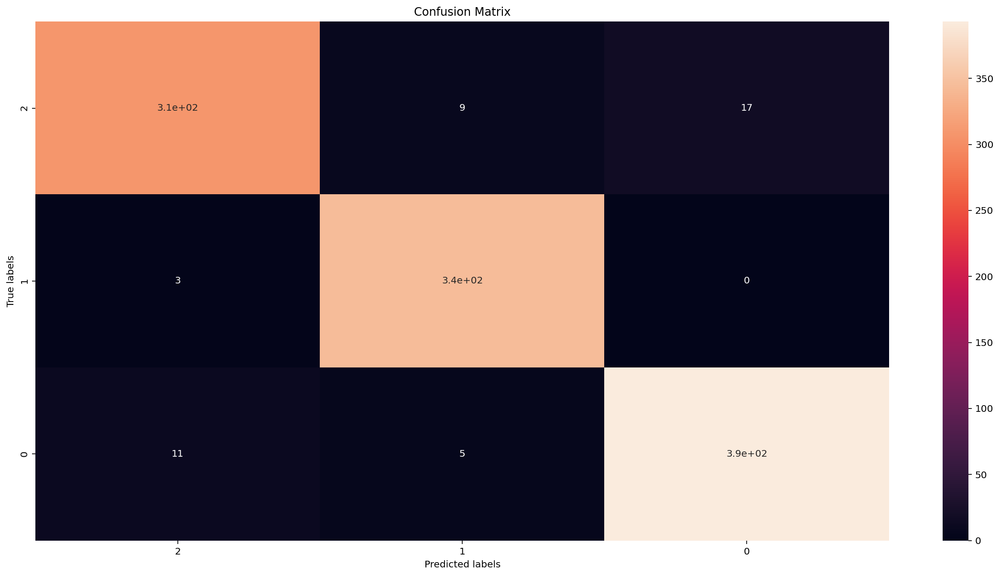

In [166]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cf_matrix, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [167]:
from sklearn.metrics import classification_report

print(classification_report(y_test, y_pred_gini))

              precision    recall  f1-score   support

           0       0.96      0.92      0.94       334
           1       0.96      0.99      0.98       348
           2       0.96      0.96      0.96       409

    accuracy                           0.96      1091
   macro avg       0.96      0.96      0.96      1091
weighted avg       0.96      0.96      0.96      1091



In [189]:
report = classification_report(y_test, y_pred_gini, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'agg_decision_tree_gini.png')

# ENTROPY CRITERION

In [168]:
from sklearn.metrics import log_loss
from sklearn.tree import DecisionTreeClassifier

training_scores = []
test_scores = []

def tree_scores(i):
    clf_gini = DecisionTreeClassifier(criterion='entropy', max_depth=i, random_state = 42)
    
    
    clf_gini.fit(X_train, y_train)
    y_pred_gini = clf_gini.predict_proba(X_test)
    y_pred_train_gini = clf_gini.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))
    training_scores.append(log_loss(y_train, y_pred_train_gini))

    print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))
    test_scores.append(log_loss(y_test, y_pred_gini))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.6585
Test set score: 0.6865
Max Depth: 2
Training set score: 0.8962
Test set score: 0.8808
Max Depth: 3
Training set score: 0.9268
Test set score: 0.9276
Max Depth: 4
Training set score: 0.9354
Test set score: 0.9358
Max Depth: 5
Training set score: 0.9519
Test set score: 0.9560
Max Depth: 6
Training set score: 0.9733
Test set score: 0.9743
Max Depth: 7
Training set score: 0.9823
Test set score: 0.9716
Max Depth: 8
Training set score: 0.9912
Test set score: 0.9771
Max Depth: 9
Training set score: 0.9965
Test set score: 0.9753
Max Depth: 10
Training set score: 0.9978
Test set score: 0.9762


Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

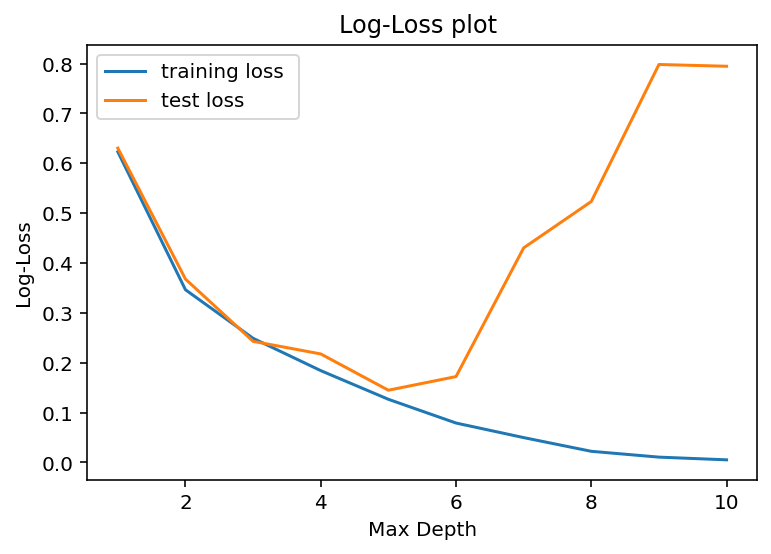

In [169]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_scores, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_scores, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [170]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='entropy', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

GridSearchCV(estimator=DecisionTreeClassifier(criterion='entropy',
                                              random_state=42),
             n_jobs=4, param_grid={'max_depth': range(1, 11)})

0.9710499490316004 {'max_depth': 9}


In [171]:
clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=5, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_en, X_train, y_train, cv=10)))

Cross-Validation Score: 0.939655846045139


In [172]:
clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=5, random_state = 42)

clf_en.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=5, random_state=42)

In [173]:
y_pred_en = clf_gini.predict(X_test)

In [174]:
print('Training set score: {:.4f}'.format(clf_en.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_en.score(X_test, y_test)))

Training set score: 0.9519
Test set score: 0.9560


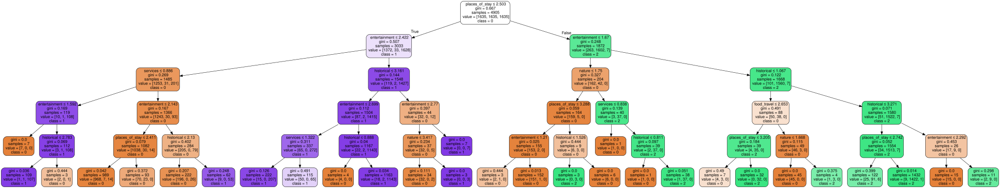

In [175]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import graphviz
from sklearn import tree



dot_data = tree.export_graphviz(clf_en, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [176]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

cf_matrix = confusion_matrix(y_test, y_pred_en)

cf_matrix

array([[308,   9,  17],
       [  3, 345,   0],
       [ 11,   5, 393]])

<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '2'), Text(1.5, 0, '1'), Text(2.5, 0, '0')]

[Text(0, 0.5, '2'), Text(0, 1.5, '1'), Text(0, 2.5, '0')]

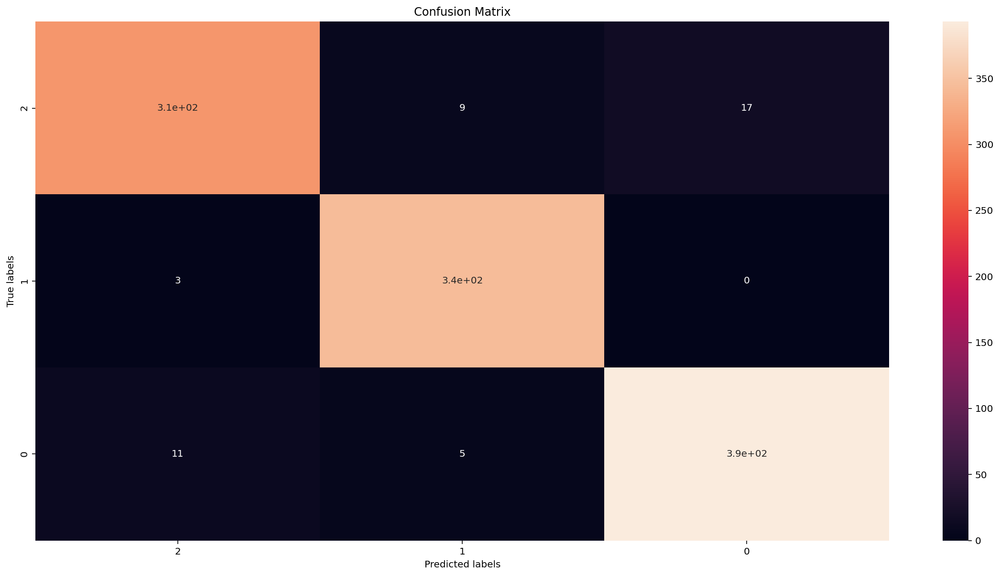

In [177]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cf_matrix, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [178]:
from sklearn.metrics import classification_report

print(classification_report(y_test, y_pred_en))

              precision    recall  f1-score   support

           0       0.96      0.92      0.94       334
           1       0.96      0.99      0.98       348
           2       0.96      0.96      0.96       409

    accuracy                           0.96      1091
   macro avg       0.96      0.96      0.96      1091
weighted avg       0.96      0.96      0.96      1091



In [181]:
import dataframe_image as dfi

report = classification_report(y_test, y_pred_en, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'agg_decision_tree_gini.png')

# GRADIENT BOOSTING

In [190]:
from sklearn.ensemble import GradientBoostingClassifier

training_loss = []
test_loss = []

def tree_scores(i):
    clf_gb = GradientBoostingClassifier( max_depth=i, random_state = 42)
    
    
    clf_gb.fit(X_train, y_train.values.ravel())
    y_pred_gb = clf_gb.predict_proba(X_test)
    y_pred_train_gb = clf_gb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_gb))

    print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_gb))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.9494
Test set score: 0.9423
Max Depth: 2
Training set score: 0.9766
Test set score: 0.9698
Max Depth: 3
Training set score: 0.9918
Test set score: 0.9826
Max Depth: 4
Training set score: 0.9998
Test set score: 0.9808
Max Depth: 5
Training set score: 1.0000
Test set score: 0.9835
Max Depth: 6
Training set score: 1.0000
Test set score: 0.9826
Max Depth: 7
Training set score: 1.0000
Test set score: 0.9835
Max Depth: 8
Training set score: 1.0000
Test set score: 0.9789
Max Depth: 9
Training set score: 1.0000
Test set score: 0.9780
Max Depth: 10
Training set score: 1.0000
Test set score: 0.9753


Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

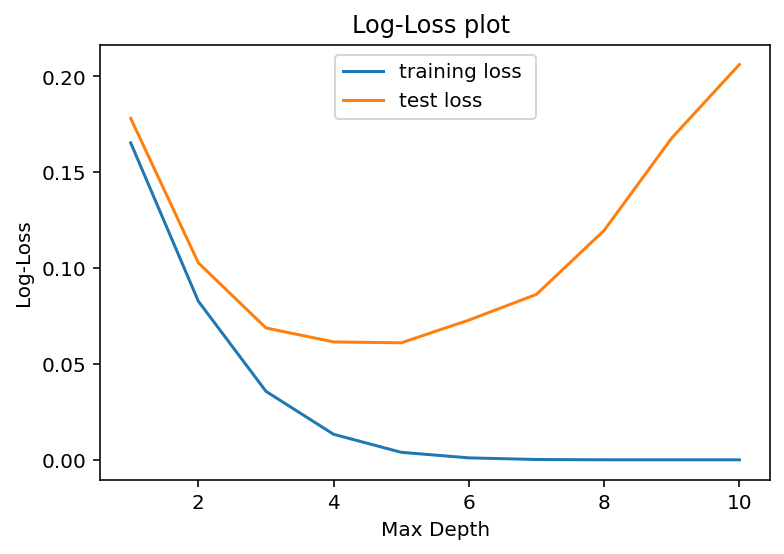

In [191]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [192]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(GradientBoostingClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

GridSearchCV(estimator=GradientBoostingClassifier(max_depth=10,
                                                  random_state=42),
             n_jobs=4, param_grid={'max_depth': range(1, 11)})

0.9845056065239552 {'max_depth': 6}


In [193]:
clf_gb = GradientBoostingClassifier( max_depth=3, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gb, X_train, y_train.values.ravel(), cv=10)))

Cross-Validation Score: 0.975534311484268


In [194]:
clf_gb = GradientBoostingClassifier( max_depth=3, random_state = 42)

clf_gb.fit(X_train, y_train.values.ravel())

GradientBoostingClassifier(random_state=42)

In [195]:
y_pred_gb = clf_gb.predict(X_test)

In [196]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))

Training set score: 0.9918
Test set score: 0.9826


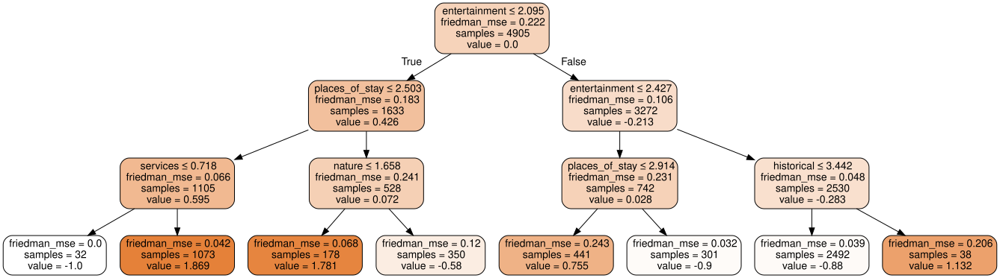

In [199]:
dot_data = tree.export_graphviz(clf_gb.estimators_[0, 0], out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [200]:
cm = confusion_matrix(y_test, y_pred_gb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[324   5   5]
 [  3 345   0]
 [  5   1 403]]


<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '2'), Text(1.5, 0, '1'), Text(2.5, 0, '0')]

[Text(0, 0.5, '2'), Text(0, 1.5, '1'), Text(0, 2.5, '0')]

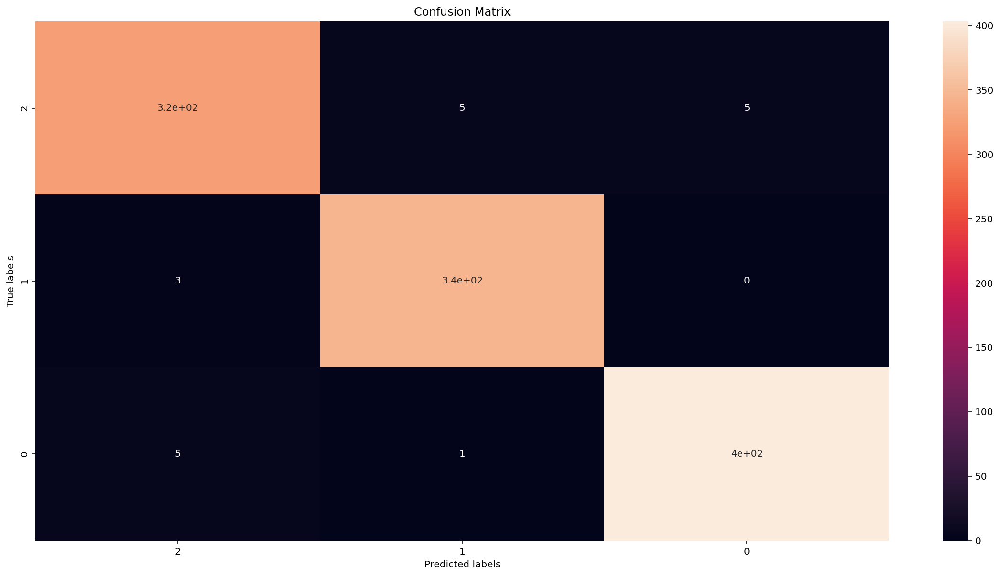

In [201]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [202]:
print(classification_report(y_test, y_pred_gb))

              precision    recall  f1-score   support

           0       0.98      0.97      0.97       334
           1       0.98      0.99      0.99       348
           2       0.99      0.99      0.99       409

    accuracy                           0.98      1091
   macro avg       0.98      0.98      0.98      1091
weighted avg       0.98      0.98      0.98      1091



In [203]:
report = classification_report(y_test, y_pred_gb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'agg_gradient_boosting.png')

# XGBOOST

In [205]:
import xgboost as xgb

training_loss = []
test_loss = []

def tree_scores(i):
    clf_xgb = xgb.XGBClassifier( max_depth=i, random_state = 42, n_jobs = 4, verbose = 0)
    
    
    clf_xgb.fit(X_train, y_train.values.ravel())
    y_pred_xgb = clf_xgb.predict_proba(X_test)
    y_pred_train_xgb = clf_xgb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_xgb))

    print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_xgb))
     
        
for i in range(1,11):
    tree_scores(i)

[17:42:06] WARNING: xgboost/src/learner.cc:541: 
Parameters: { verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[17:42:06] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 1
Training set score: 0.9645
Test set score: 0.9597
[17:42:07] WARNING: xgboost/src/learner.cc:541: 
Parameters: { verbose } might not be used.

  This may not be accurate due to some parameters are only used in language bindings but
  passed down to XGBoost core.  Or some parameters are not used but slip through this
  verification. Please open an issue if you find above cases.


[17:42:07] WARN

Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

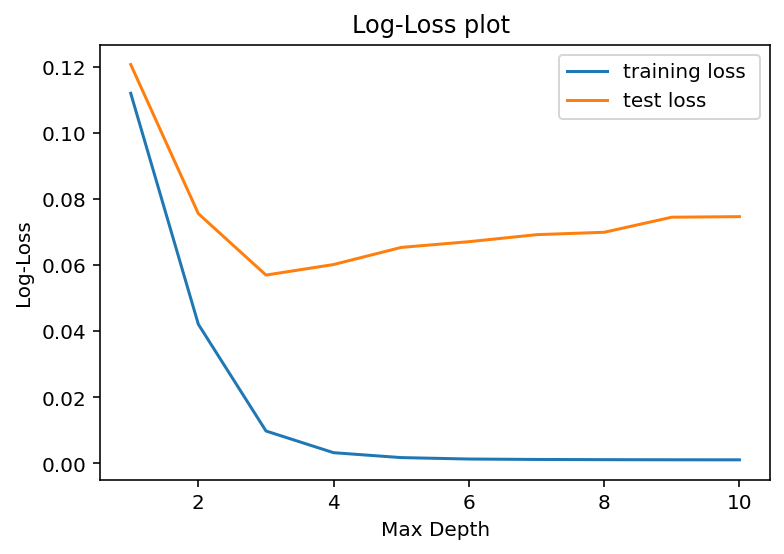

In [206]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [207]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(xgb.XGBClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

[17:45:06] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


GridSearchCV(estimator=XGBClassifier(base_score=None, booster=None,
                                     colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, gamma=None,
                                     gpu_id=None, importance_type='gain',
                                     interaction_constraints=None,
                                     learning_rate=None, max_delta_step=None,
                                     max_depth=10, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     num_parallel_tree=None, random_state=42,
                                     reg_alpha=None, reg_lambda=None,
                                     scale_pos_weight=None, subsample=None,
                                     tree_method=None, validate_parameters=No

0.9861365953109071 {'max_depth': 7}


In [208]:
clf_xgb = xgb.XGBClassifier( max_depth=3, random_state = 42, n_jobs = 4)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_xgb, X_train, y_train.values.ravel(), cv=10)))

[17:45:14] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:45:15] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:45:17] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[17:45:18] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd li

In [211]:
clf_xgb = xgb.XGBClassifier( max_depth=4, random_state = 42, n_jobs = 4)

clf_xgb.fit(X_train, y_train.values.ravel())

[17:46:04] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=4,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1,
              objective='multi:softprob', random_state=42, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [212]:
y_pred_xgb = clf_xgb.predict(X_test)

In [213]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))

Training set score: 1.0000
Test set score: 0.9808


<AxesSubplot:>

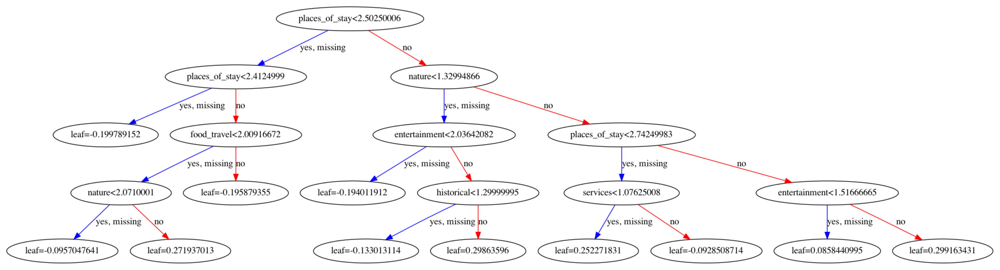

In [214]:
fig, ax = plt.subplots(figsize=(30, 30))
xgb.plot_tree(clf_xgb, num_trees=4, ax=ax)
plt.show()

In [215]:
cm = confusion_matrix(y_test, y_pred_xgb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[324   5   5]
 [  3 345   0]
 [  6   2 401]]


<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '2'), Text(1.5, 0, '1'), Text(2.5, 0, '0')]

[Text(0, 0.5, '2'), Text(0, 1.5, '1'), Text(0, 2.5, '0')]

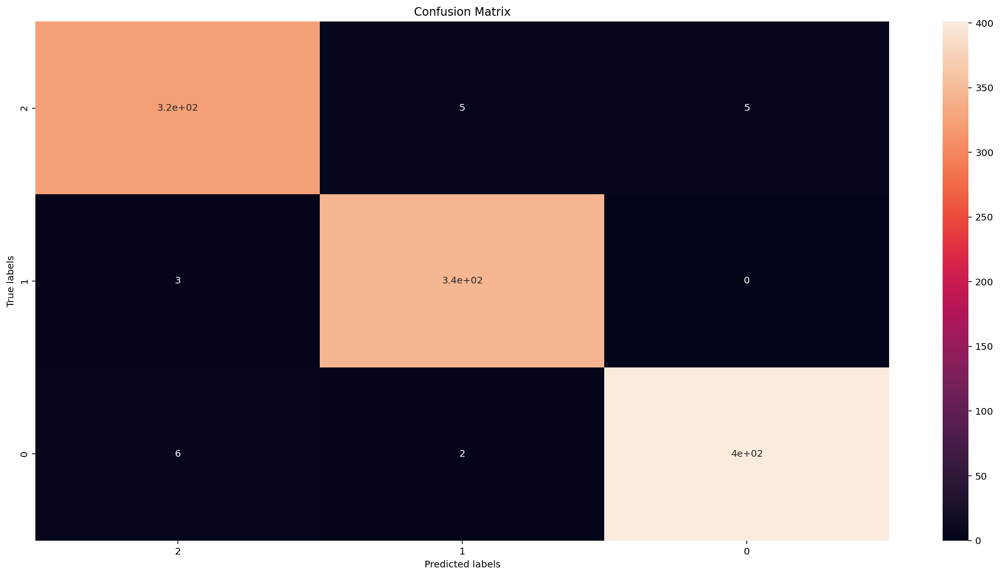

In [216]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [217]:
print(classification_report(y_test, y_pred_xgb))

              precision    recall  f1-score   support

           0       0.97      0.97      0.97       334
           1       0.98      0.99      0.99       348
           2       0.99      0.98      0.98       409

    accuracy                           0.98      1091
   macro avg       0.98      0.98      0.98      1091
weighted avg       0.98      0.98      0.98      1091



In [218]:
report = classification_report(y_test, y_pred_xgb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'agg_xgb.png')

<h3 id="DBSCAN_Dataset">
3.2 DBSCAN Dataset
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#DBSCAN_Dataset">¶</a>
</h3>

### 3.2.1 Decision Tree

In [220]:
df_db.describe()

,entertainment,food_travel,places_of_stay,historical,nature,services,DBLabels
count,3021.000000,3021.000000,3021.000000,3021.000000,3021.000000,3021.000000,3021.000000
mean,2.437307,2.062947,2.088865,1.988526,2.090193,1.211691,0.504469
std,0.618040,0.486937,0.827863,0.458757,0.542853,0.472604,1.288152
min,1.120000,0.865000,1.000000,0.572500,0.576000,0.207500,0.000000
25%,1.996667,1.703333,1.440000,1.690000,1.726000,0.887500,0.000000
50%,2.430000,2.088333,1.795000,1.952500,2.028000,1.175000,0.000000
75%,2.860000,2.441667,2.950000,2.232500,2.452000,1.475000,0.000000
max,3.973333,3.643333,3.950000,3.492500,3.732000,3.220000,6.000000


In [222]:
df_db.drop_duplicates()

,entertainment,food_travel,places_of_stay,historical,nature,services,DBLabels
37,2.823333,1.351667,1.080,1.2775,2.432,0.5425,0
40,2.880000,1.268333,1.075,1.4050,1.502,1.3850,0
45,2.490000,1.400000,1.060,1.3150,2.564,0.5325,0
46,2.486667,1.396667,1.060,1.3150,2.420,0.5200,0
48,2.510000,1.393333,1.060,1.8300,2.426,0.5225,0
...,...,...,...,...,...,...,...
5399,1.340000,1.056667,1.720,2.1575,2.960,0.9575,6
5401,1.340000,1.705000,1.715,2.1025,2.902,0.9600,6
5402,1.343333,1.728333,1.715,2.1050,2.888,1.0325,6
5406,2.810000,1.075000,1.780,2.5400,3.024,1.0625,0


In [223]:
for col in df_db.columns:
    print(df_db[col].value_counts())

2.373333    95
2.803333    66
2.430000    53
2.806667    47
2.376667    44
            ..
1.196667     1
2.543333     1
2.596667     1
1.653333     1
1.330000     1
Name: entertainment, Length: 725, dtype: int64
1.951667    11
2.343333    11
2.475000    10
1.528333    10
1.526667     9
            ..
2.771667     1
1.023333     1
2.275000     1
2.710000     1
2.625000     1
Name: food_travel, Length: 1429, dtype: int64
1.440    61
1.475    50
1.470    45
1.465    39
1.130    39
         ..
3.200     1
2.560     1
1.300     1
1.800     1
3.125     1
Name: places_of_stay, Length: 547, dtype: int64
2.2150    16
1.6150    15
1.6025    15
2.2400    14
1.6050    14
          ..
1.3125     1
1.2675     1
2.8425     1
1.3000     1
1.3750     1
Name: historical, Length: 1091, dtype: int64
1.972    12
1.800    11
2.032    11
2.118    11
2.040    10
         ..
2.374     1
3.204     1
2.236     1
2.426     1
2.146     1
Name: nature, Length: 1366, dtype: int64
1.2500    46
1.2825    36
1.3775    

In [224]:
X = df_db.drop(['DBLabels'], axis = 1)
y = df_db['DBLabels']

In [225]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state = 42, stratify=y)

In [226]:
print(y_test.value_counts()) #we secured the 20% in the classes represenation

0    496
2     38
1     27
5     16
6     10
4      9
3      9
Name: DBLabels, dtype: int64


In [227]:
sm = SMOTE(random_state = 42)
           
X_train, y_train = sm.fit_sample(X_train, y_train) 

In [228]:
print(y_train.value_counts())

6    1981
5    1981
4    1981
3    1981
2    1981
1    1981
0    1981
Name: DBLabels, dtype: int64


# GINI CRITERION

In [229]:
training_scores = []
test_scores = []

def tree_scores(i):
    clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=i, random_state = 42)
    
    
    clf_gini.fit(X_train, y_train)
    y_pred_gini = clf_gini.predict_proba(X_test)
    y_pred_train_gini = clf_gini.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))
    training_scores.append(log_loss(y_train, y_pred_train_gini))

    print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))
    test_scores.append(log_loss(y_test, y_pred_gini))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.2857
Test set score: 0.0579
Max Depth: 2
Training set score: 0.5702
Test set score: 0.0975
Max Depth: 3
Training set score: 0.8620
Test set score: 0.2512
Max Depth: 4
Training set score: 0.9712
Test set score: 0.8529
Max Depth: 5
Training set score: 0.9927
Test set score: 0.9785
Max Depth: 6
Training set score: 0.9976
Test set score: 0.9934
Max Depth: 7
Training set score: 0.9987
Test set score: 0.9934
Max Depth: 8
Training set score: 0.9994
Test set score: 0.9934
Max Depth: 9
Training set score: 0.9994
Test set score: 0.9934
Max Depth: 10
Training set score: 0.9999
Test set score: 0.9934


Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

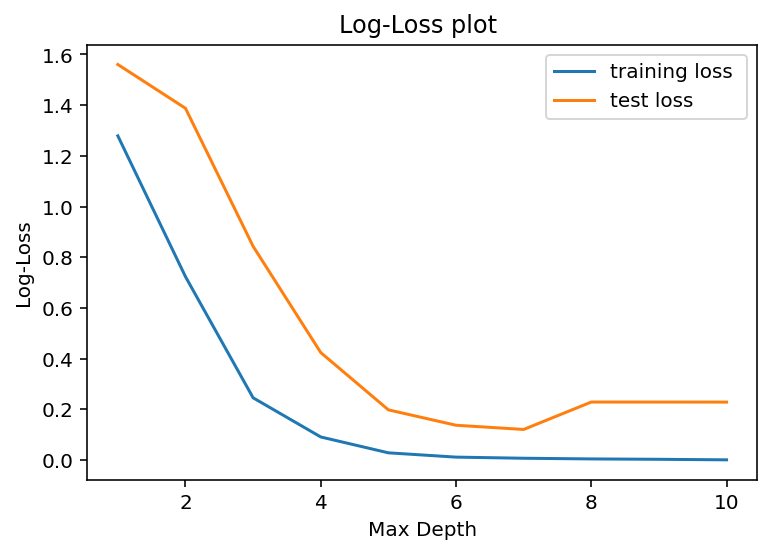

In [230]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_scores, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_scores, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [231]:
from sklearn.model_selection import GridSearchCV

parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='gini', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

GridSearchCV(estimator=DecisionTreeClassifier(random_state=42), n_jobs=4,
             param_grid={'max_depth': range(1, 11)})

0.9980528845591345 {'max_depth': 10}


In [232]:
clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=7, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gini, X_train, y_train, cv=10)))

Cross-Validation Score: 0.9968991594802699


In [233]:
clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=7, random_state = 42)

clf_gini.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=7, random_state=42)

In [234]:
y_pred_gini = clf_gini.predict(X_test)

In [236]:
print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))

Training set score: 0.9987
Test set score: 0.9934


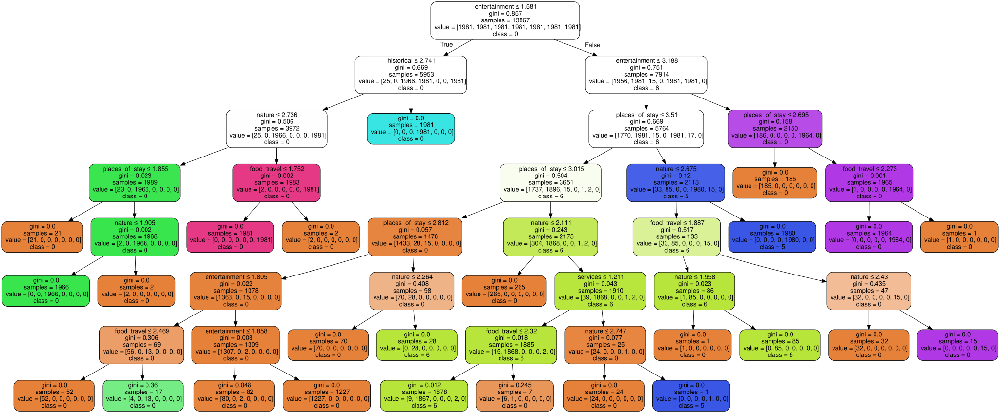

In [238]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import graphviz
from sklearn import tree



dot_data = tree.export_graphviz(clf_gini, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [239]:
cf_matrix = confusion_matrix(y_test, y_pred_gini)

cf_matrix

array([[494,   0,   2,   0,   0,   0,   0],
       [  0,  27,   0,   0,   0,   0,   0],
       [  0,   0,  38,   0,   0,   0,   0],
       [  1,   0,   0,   8,   0,   0,   0],
       [  0,   0,   0,   0,   9,   0,   0],
       [  0,   0,   0,   0,   0,  16,   0],
       [  1,   0,   0,   0,   0,   0,   9]])

<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '0'),
 Text(1.5, 0, '3'),
 Text(2.5, 0, '1'),
 Text(3.5, 0, '2'),
 Text(4.5, 0, '6'),
 Text(5.5, 0, '4'),
 Text(6.5, 0, '5')]

[Text(0, 0.5, '0'),
 Text(0, 1.5, '3'),
 Text(0, 2.5, '1'),
 Text(0, 3.5, '2'),
 Text(0, 4.5, '6'),
 Text(0, 5.5, '4'),
 Text(0, 6.5, '5')]

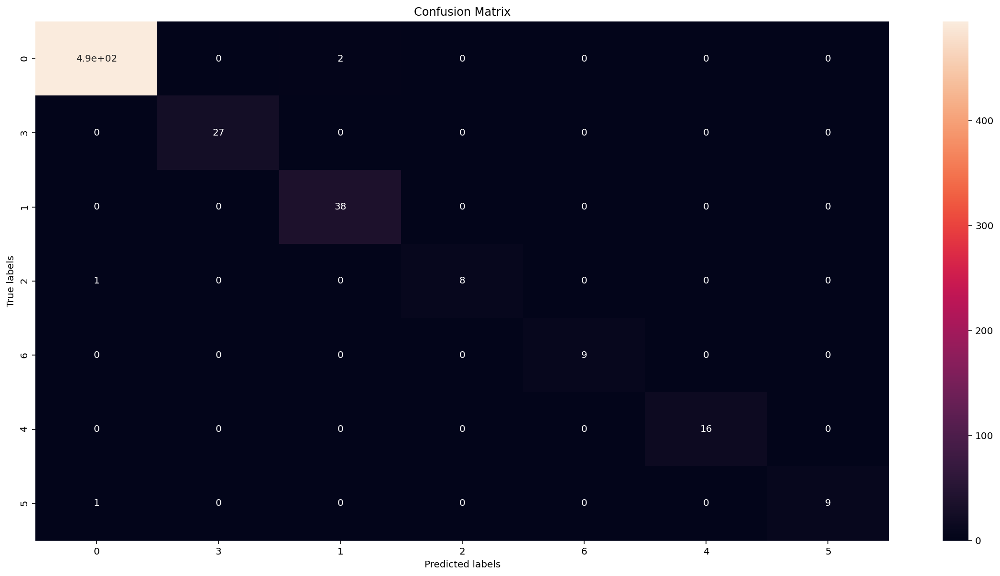

In [240]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cf_matrix, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [241]:
print(classification_report(y_test, y_pred_gini))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       496
           1       1.00      1.00      1.00        27
           2       0.95      1.00      0.97        38
           3       1.00      0.89      0.94         9
           4       1.00      1.00      1.00         9
           5       1.00      1.00      1.00        16
           6       1.00      0.90      0.95        10

    accuracy                           0.99       605
   macro avg       0.99      0.97      0.98       605
weighted avg       0.99      0.99      0.99       605



In [242]:
report = classification_report(y_test, y_pred_gini, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'db_gini.png')

# ENTROPY CRITERION

In [243]:
training_loss = []
test_loss = []

def tree_scores(i):
    clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=i, random_state = 42)
    
    
    clf_en.fit(X_train, y_train)
    y_pred_en = clf_en.predict_proba(X_test)
    y_pred_train_en = clf_en.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_en.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_en))

    print('Test set score: {:.4f}'.format(clf_en.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_en))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.2857
Test set score: 0.0579
Max Depth: 2
Training set score: 0.5702
Test set score: 0.0975
Max Depth: 3
Training set score: 0.8620
Test set score: 0.2512
Max Depth: 4
Training set score: 0.9682
Test set score: 0.8298
Max Depth: 5
Training set score: 0.9948
Test set score: 0.9802
Max Depth: 6
Training set score: 0.9975
Test set score: 0.9934
Max Depth: 7
Training set score: 0.9991
Test set score: 0.9934
Max Depth: 8
Training set score: 0.9993
Test set score: 0.9934
Max Depth: 9
Training set score: 0.9999
Test set score: 0.9934
Max Depth: 10
Training set score: 0.9999
Test set score: 0.9934


Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

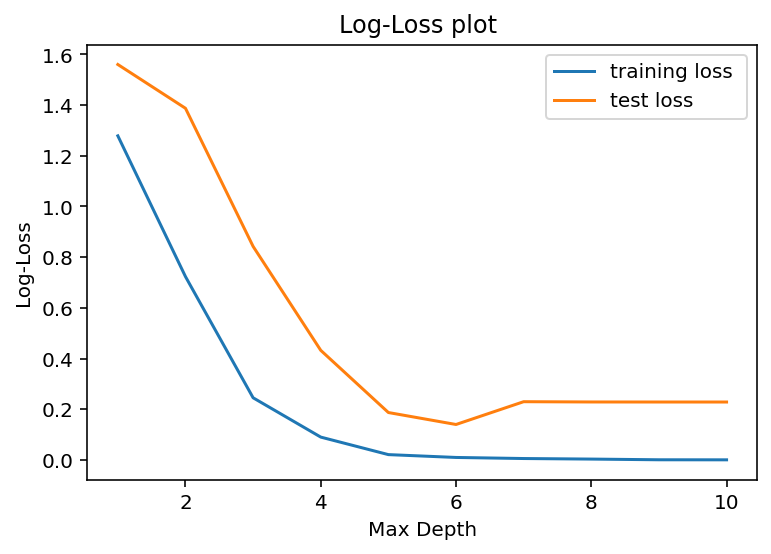

In [244]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [245]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='entropy', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

GridSearchCV(estimator=DecisionTreeClassifier(criterion='entropy',
                                              random_state=42),
             n_jobs=4, param_grid={'max_depth': range(1, 11)})

0.9987019750394615 {'max_depth': 10}


In [246]:
clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=6, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_en, X_train, y_train, cv=10)))

Cross-Validation Score: 0.9962499128685142


In [247]:
clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=6, random_state = 42)

clf_en.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=6, random_state=42)

In [248]:
y_pred_en = clf_en.predict(X_test)

In [249]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_en.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_en.score(X_test, y_test)))

Training set score: 0.9975
Test set score: 0.9934


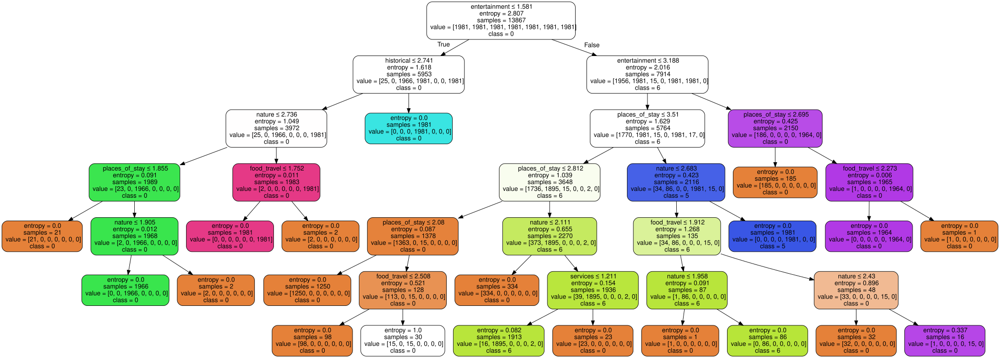

In [250]:
dot_data = tree.export_graphviz(clf_en, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [251]:
cm = confusion_matrix(y_test, y_pred_en)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[494   2   0   0   0   0   0]
 [  0  27   0   0   0   0   0]
 [  0   0  38   0   0   0   0]
 [  1   0   0   8   0   0   0]
 [  0   0   0   0   9   0   0]
 [  0   0   0   0   0  16   0]
 [  1   0   0   0   0   0   9]]


<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '0'),
 Text(1.5, 0, '3'),
 Text(2.5, 0, '1'),
 Text(3.5, 0, '2'),
 Text(4.5, 0, '6'),
 Text(5.5, 0, '4'),
 Text(6.5, 0, '5')]

[Text(0, 0.5, '0'),
 Text(0, 1.5, '3'),
 Text(0, 2.5, '1'),
 Text(0, 3.5, '2'),
 Text(0, 4.5, '6'),
 Text(0, 5.5, '4'),
 Text(0, 6.5, '5')]

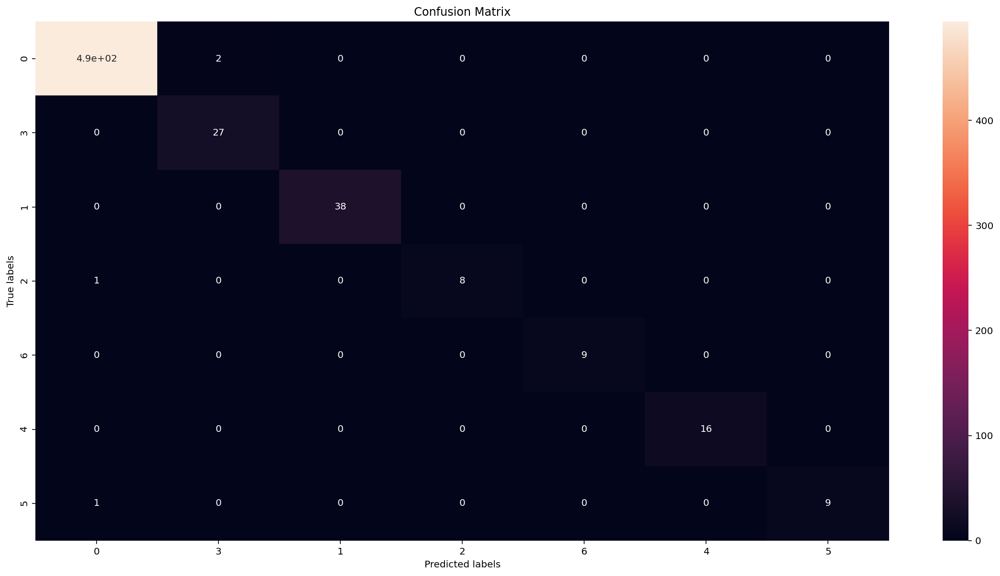

In [252]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [253]:
print(classification_report(y_test, y_pred_en))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       496
           1       0.93      1.00      0.96        27
           2       1.00      1.00      1.00        38
           3       1.00      0.89      0.94         9
           4       1.00      1.00      1.00         9
           5       1.00      1.00      1.00        16
           6       1.00      0.90      0.95        10

    accuracy                           0.99       605
   macro avg       0.99      0.97      0.98       605
weighted avg       0.99      0.99      0.99       605



In [254]:
report = classification_report(y_test, y_pred_en, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'db_entropy.png')

# GRADIENT BOOSTING

In [255]:
from sklearn.ensemble import GradientBoostingClassifier

training_loss = []
test_loss = []

def tree_scores(i):
    clf_gb = GradientBoostingClassifier( max_depth=i, random_state = 42)
    
    
    clf_gb.fit(X_train, y_train.values.ravel())
    y_pred_gb = clf_gb.predict_proba(X_test)
    y_pred_train_gb = clf_gb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_gb))

    print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_gb))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.9979
Test set score: 0.9851
Max Depth: 2
Training set score: 0.9997
Test set score: 0.9835
Max Depth: 3
Training set score: 1.0000
Test set score: 0.9901
Max Depth: 4
Training set score: 1.0000
Test set score: 0.9934
Max Depth: 5
Training set score: 1.0000
Test set score: 0.9950
Max Depth: 6
Training set score: 1.0000
Test set score: 0.9934
Max Depth: 7
Training set score: 1.0000
Test set score: 0.9917
Max Depth: 8
Training set score: 1.0000
Test set score: 0.9901
Max Depth: 9
Training set score: 1.0000
Test set score: 0.9934
Max Depth: 10
Training set score: 1.0000
Test set score: 0.9950


Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

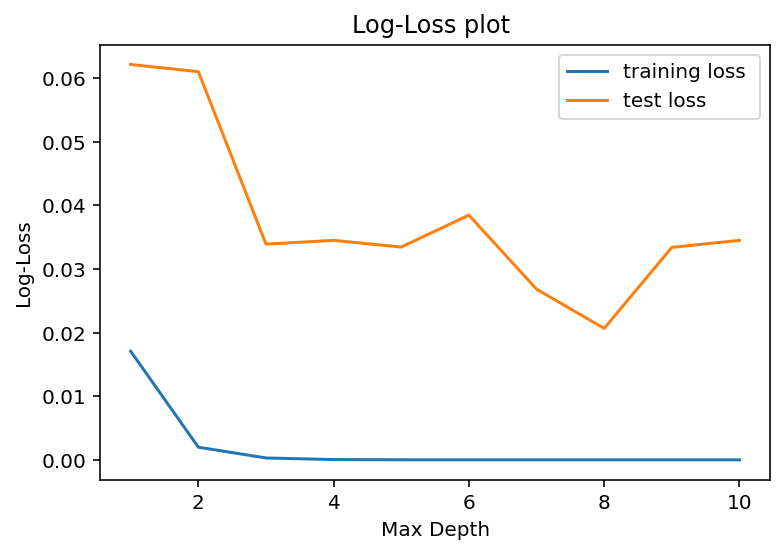

In [256]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [257]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(GradientBoostingClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

GridSearchCV(estimator=GradientBoostingClassifier(max_depth=10,
                                                  random_state=42),
             n_jobs=4, param_grid={'max_depth': range(1, 11)})

0.9985576749326794 {'max_depth': 3}


In [258]:
clf_gb = GradientBoostingClassifier( max_depth=8, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gb, X_train, y_train.values.ravel(), cv=10)))

KeyboardInterrupt: 

In [259]:
clf_gb = GradientBoostingClassifier( max_depth=8, random_state = 42)

clf_gb.fit(X_train, y_train.values.ravel())

GradientBoostingClassifier(max_depth=8, random_state=42)

In [260]:
y_pred_gb = clf_gb.predict(X_test)

In [261]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))

Training set score: 1.0000
Test set score: 0.9901


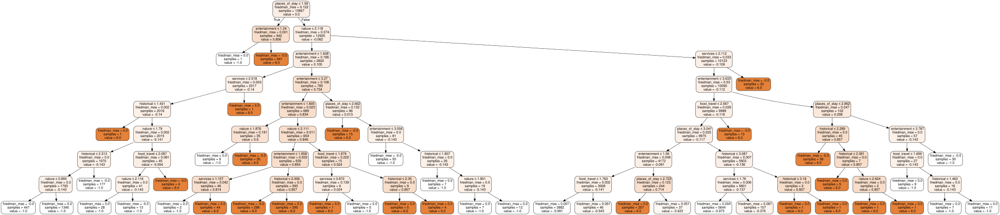

In [262]:
dot_data = tree.export_graphviz(clf_gb.estimators_[0, 0], out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [263]:
cm = confusion_matrix(y_test, y_pred_gb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[495   0   0   0   0   0   1]
 [  0  27   0   0   0   0   0]
 [  0   0  38   0   0   0   0]
 [  0   0   0   9   0   0   0]
 [  0   0   0   0   9   0   0]
 [  1   0   0   0   3  12   0]
 [  1   0   0   0   0   0   9]]


<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '0'),
 Text(1.5, 0, '3'),
 Text(2.5, 0, '1'),
 Text(3.5, 0, '2'),
 Text(4.5, 0, '6'),
 Text(5.5, 0, '4'),
 Text(6.5, 0, '5')]

[Text(0, 0.5, '0'),
 Text(0, 1.5, '3'),
 Text(0, 2.5, '1'),
 Text(0, 3.5, '2'),
 Text(0, 4.5, '6'),
 Text(0, 5.5, '4'),
 Text(0, 6.5, '5')]

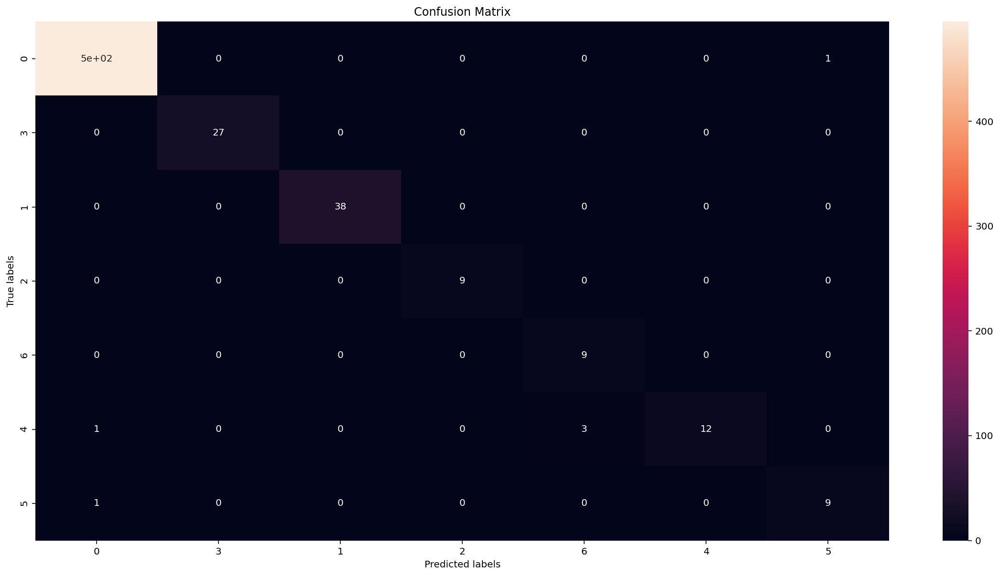

In [264]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [265]:
print(classification_report(y_test, y_pred_gb))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       496
           1       1.00      1.00      1.00        27
           2       1.00      1.00      1.00        38
           3       1.00      1.00      1.00         9
           4       0.75      1.00      0.86         9
           5       1.00      0.75      0.86        16
           6       0.90      0.90      0.90        10

    accuracy                           0.99       605
   macro avg       0.95      0.95      0.94       605
weighted avg       0.99      0.99      0.99       605



In [282]:
report = classification_report(y_test, y_pred_gb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'db_gb.png')

# XGBOOST

In [267]:
import xgboost as xgb

training_loss = []
test_loss = []

def tree_scores(i):
    clf_xgb = xgb.XGBClassifier( max_depth=i, random_state = 42, n_jobs = 4)
    
    
    clf_xgb.fit(X_train, y_train.values.ravel())
    y_pred_xgb = clf_xgb.predict_proba(X_test)
    y_pred_train_xgb = clf_xgb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_xgb))

    print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_xgb))
     
        
for i in range(1,11):
    tree_scores(i)

[20:49:11] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 1
Training set score: 0.9992
Test set score: 0.9901
[20:49:13] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 2
Training set score: 1.0000
Test set score: 0.9917
[20:49:16] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 3
Training set score: 1.0000
Test set score: 0.9934
[20:49:23] WARNING: xgboost/src/learn

Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

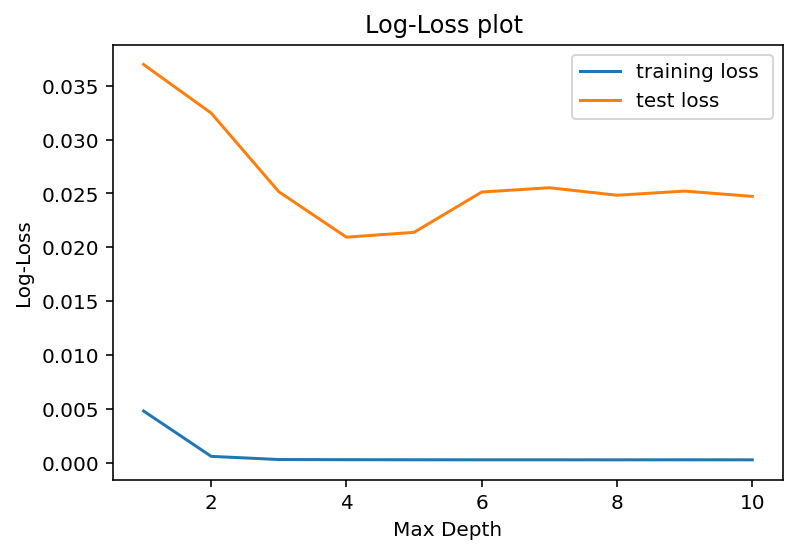

In [268]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [269]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(xgb.XGBClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

[20:53:28] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


GridSearchCV(estimator=XGBClassifier(base_score=None, booster=None,
                                     colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, gamma=None,
                                     gpu_id=None, importance_type='gain',
                                     interaction_constraints=None,
                                     learning_rate=None, max_delta_step=None,
                                     max_depth=10, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     num_parallel_tree=None, random_state=42,
                                     reg_alpha=None, reg_lambda=None,
                                     scale_pos_weight=None, subsample=None,
                                     tree_method=None, validate_parameters=No

0.998774073092814 {'max_depth': 2}


In [270]:
clf_xgb = xgb.XGBClassifier( max_depth=4, random_state = 42, n_jobs = 4)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_xgb, X_train, y_train.values.ravel(), cv=10)))

[20:53:43] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:53:45] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:53:47] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[20:53:50] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd li

In [271]:
clf_xgb = xgb.XGBClassifier( max_depth=4, random_state = 42, n_jobs = 4)

clf_xgb.fit(X_train, y_train.values.ravel())

[20:54:18] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=4,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1,
              objective='multi:softprob', random_state=42, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [272]:
y_pred_xgb = clf_xgb.predict(X_test)

In [273]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))

Training set score: 1.0000
Test set score: 0.9934


<AxesSubplot:>

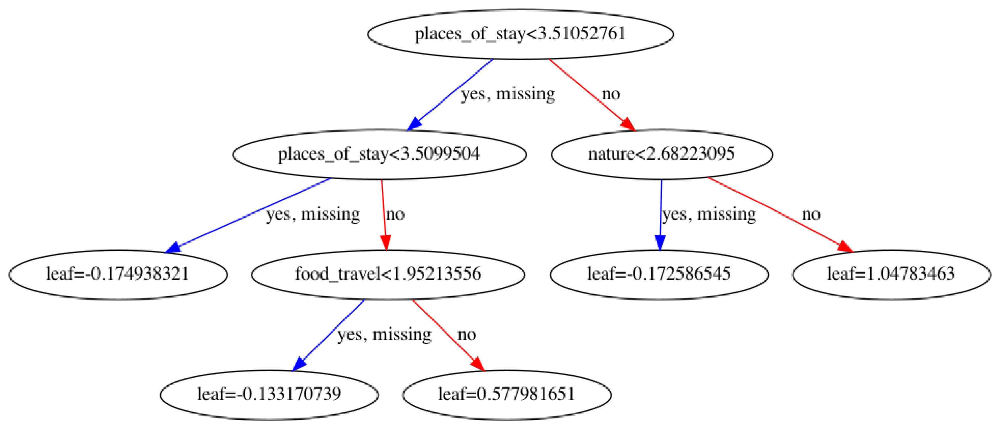

In [274]:
fig, ax = plt.subplots(figsize=(30, 30))
xgb.plot_tree(clf_xgb, num_trees=4, ax=ax)
plt.show()

In [275]:
cm = confusion_matrix(y_test, y_pred_xgb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[494   2   0   0   0   0   0]
 [  0  27   0   0   0   0   0]
 [  0   0  38   0   0   0   0]
 [  1   0   0   8   0   0   0]
 [  0   0   0   0   9   0   0]
 [  0   0   0   0   0  16   0]
 [  1   0   0   0   0   0   9]]


<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '0'),
 Text(1.5, 0, '3'),
 Text(2.5, 0, '1'),
 Text(3.5, 0, '2'),
 Text(4.5, 0, '6'),
 Text(5.5, 0, '4'),
 Text(6.5, 0, '5')]

[Text(0, 0.5, '0'),
 Text(0, 1.5, '3'),
 Text(0, 2.5, '1'),
 Text(0, 3.5, '2'),
 Text(0, 4.5, '6'),
 Text(0, 5.5, '4'),
 Text(0, 6.5, '5')]

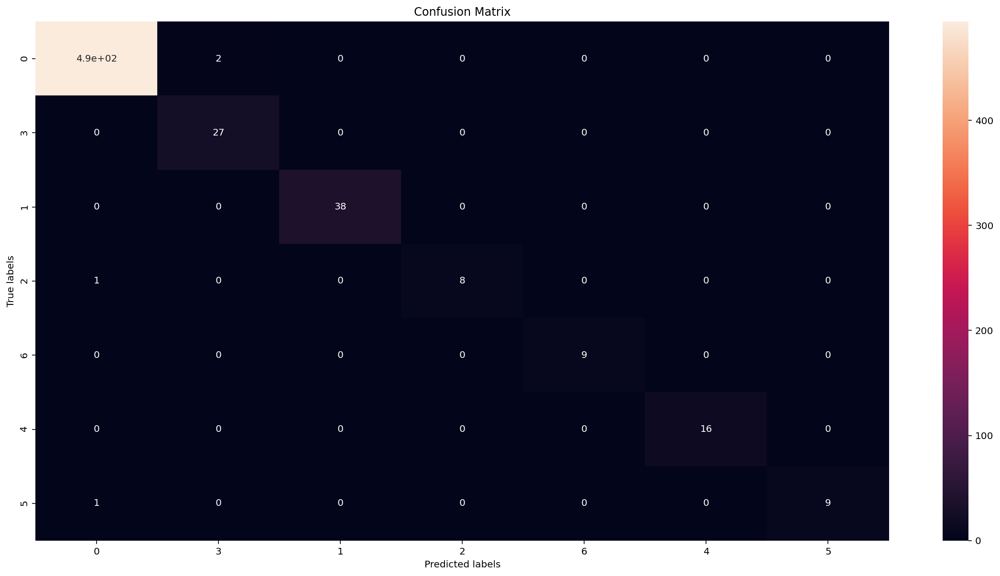

In [276]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [277]:
print(classification_report(y_test, y_pred_xgb))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       496
           1       0.93      1.00      0.96        27
           2       1.00      1.00      1.00        38
           3       1.00      0.89      0.94         9
           4       1.00      1.00      1.00         9
           5       1.00      1.00      1.00        16
           6       1.00      0.90      0.95        10

    accuracy                           0.99       605
   macro avg       0.99      0.97      0.98       605
weighted avg       0.99      0.99      0.99       605



In [283]:
report = classification_report(y_test, y_pred_xgb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'db_xgb.png')

<h3 id="EM-GMM_Dataset">
3.3 EM-GMM Dataset
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#EM-GMM_Dataset">¶</a>
</h3>

### 3.3.1 Decision Tree

In [285]:
df_gmm.describe()

,entertainment,food_travel,places_of_stay,historical,nature,services,gmm
count,5453.000000,5453.000000,5453.000000,5453.000000,5453.000000,5453.000000,5453.000000
mean,2.500826,2.027232,2.222958,2.022007,2.227858,1.330423,2.440858
std,0.722012,0.549363,0.886562,0.585001,0.662444,0.580707,1.705703
min,1.120000,0.721667,0.730000,0.557500,0.576000,0.205000,0.000000
25%,1.963333,1.650000,1.470000,1.647500,1.762000,0.937500,1.000000
50%,2.453333,2.028333,1.885000,1.977500,2.160000,1.245000,2.000000
75%,2.916667,2.433333,3.160000,2.392500,2.656000,1.685000,4.000000
max,5.000000,3.873333,5.000000,4.322500,4.520000,3.937500,5.000000


In [286]:
df_gmm.drop_duplicates()

,entertainment,food_travel,places_of_stay,historical,nature,services,gmm
0,3.530000,1.480000,0.850,1.1650,1.926,0.5500,5
1,3.530000,1.481667,0.850,1.1650,1.984,0.5500,5
2,3.530000,1.480000,0.850,1.1650,1.980,0.5500,5
3,3.530000,1.480000,1.100,1.1650,1.922,0.5575,5
5,3.530000,1.481667,0.845,1.1650,1.978,0.5525,5
...,...,...,...,...,...,...,...
5451,1.953333,1.150000,3.145,3.3700,2.888,1.8325,2
5452,1.733333,1.290000,3.135,2.3475,2.794,0.9800,2
5453,1.726667,1.135000,3.040,2.3450,2.798,1.8150,2
5454,1.730000,1.126667,2.555,3.3475,2.802,1.8100,1


In [288]:
for col in df_gmm.columns:
    print(df_gmm[col].value_counts())

2.373333    118
2.803333     77
2.893333     60
2.430000     57
2.806667     56
           ... 
1.980000      1
2.596667      1
2.206667      1
3.096667      1
4.386667      1
Name: entertainment, Length: 1024, dtype: int64
2.343333    15
1.715000    13
2.360000    13
1.030000    13
1.033333    12
            ..
3.006667     1
2.038333     1
1.581667     1
1.185000     1
1.583333     1
Name: food_travel, Length: 2012, dtype: int64
1.710    91
1.440    75
1.060    69
2.500    63
1.080    62
         ..
2.060     1
1.670     1
1.215     1
2.110     1
1.340     1
Name: places_of_stay, Length: 694, dtype: int64
1.6025    22
2.2150    22
1.6150    21
2.0800    20
1.6100    19
          ..
1.5750     1
3.7725     1
1.6525     1
2.9300     1
3.7850     1
Name: historical, Length: 1592, dtype: int64
1.832    14
1.972    13
2.364    13
2.014    13
1.680    12
         ..
3.620     1
3.348     1
1.860     1
3.026     1
1.124     1
Name: nature, Length: 1962, dtype: int64
1.2500    64
1.2825    4

In [289]:
X = df_gmm.drop(['gmm'], axis = 1)
y = df_gmm['gmm']

In [290]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state = 42, stratify=y)

In [291]:
print(y_test.value_counts()) #we secured the 20% in the classes represenation

2    211
3    202
0    200
5    187
1    155
4    136
Name: gmm, dtype: int64


In [292]:
sm = SMOTE(random_state = 42)
           
X_train, y_train = sm.fit_sample(X_train, y_train) 

In [293]:
print(y_train.value_counts())

3    844
2    844
5    844
1    844
4    844
0    844
Name: gmm, dtype: int64


# GINI CRITERION

In [294]:
from sklearn.metrics import log_loss
from sklearn.tree import DecisionTreeClassifier

training_scores = []
test_scores = []

def tree_scores(i):
    clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=i, random_state = 42)
    
    
    clf_gini.fit(X_train, y_train)
    y_pred_gini = clf_gini.predict_proba(X_test)
    y_pred_train_gini = clf_gini.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))
    training_scores.append(log_loss(y_train, y_pred_train_gini))

    print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))
    test_scores.append(log_loss(y_test, y_pred_gini))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.3331
Test set score: 0.3630
Max Depth: 2
Training set score: 0.6055
Test set score: 0.6013
Max Depth: 3
Training set score: 0.7632
Test set score: 0.7443
Max Depth: 4
Training set score: 0.8438
Test set score: 0.8213
Max Depth: 5
Training set score: 0.8726
Test set score: 0.8588
Max Depth: 6
Training set score: 0.9072
Test set score: 0.8909
Max Depth: 7
Training set score: 0.9368
Test set score: 0.8983
Max Depth: 8
Training set score: 0.9560
Test set score: 0.9065
Max Depth: 9
Training set score: 0.9666
Test set score: 0.9138
Max Depth: 10
Training set score: 0.9743
Test set score: 0.9203


Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

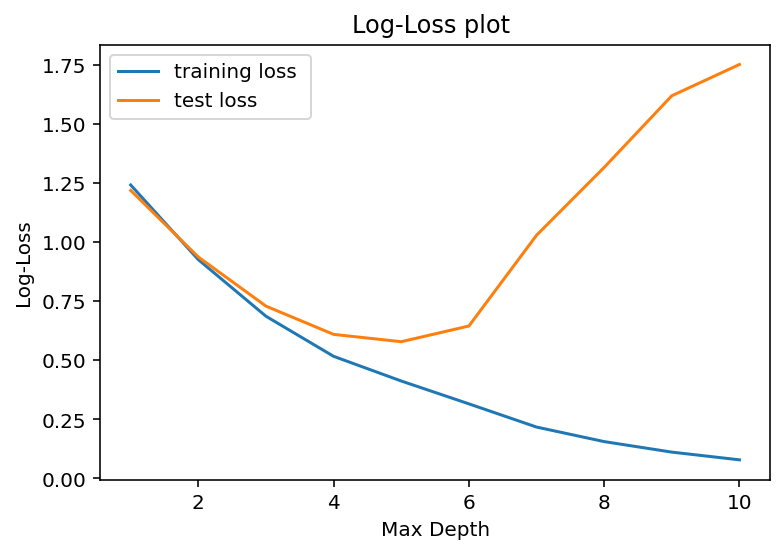

In [295]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_scores, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_scores, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [296]:
from sklearn.model_selection import GridSearchCV

parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='gini', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

GridSearchCV(estimator=DecisionTreeClassifier(random_state=42), n_jobs=4,
             param_grid={'max_depth': range(1, 11)})

0.9233845385482795 {'max_depth': 9}


In [297]:
from sklearn.model_selection import cross_val_score

clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=5, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gini, X_train, y_train, cv=10)))

Cross-Validation Score: 0.8540773050806495


In [298]:
clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=5, random_state = 42)

clf_gini.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=5, random_state=42)

In [299]:
y_pred_gini = clf_gini.predict(X_test)

In [300]:
print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))

Training set score: 0.8726
Test set score: 0.8588


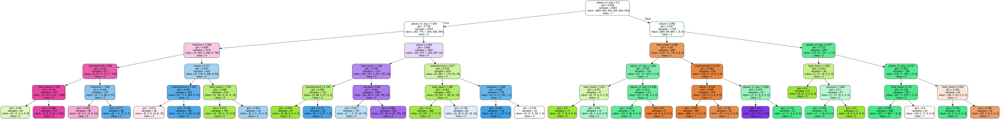

In [302]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import graphviz
from sklearn import tree



dot_data = tree.export_graphviz(clf_gini, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [303]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

cf_matrix = confusion_matrix(y_test, y_pred_gini)

cf_matrix

array([[185,   0,   5,   0,  10,   0],
       [  0, 117,   8,  13,  13,   4],
       [  8,   1, 201,   1,   0,   0],
       [  0,  13,   0, 155,  17,  17],
       [  0,   3,   0,  15, 117,   1],
       [  0,   8,   0,  12,   5, 162]])

<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '5'),
 Text(1.5, 0, '3'),
 Text(2.5, 0, '1'),
 Text(3.5, 0, '4'),
 Text(4.5, 0, '0'),
 Text(5.5, 0, '2')]

[Text(0, 0.5, '5'),
 Text(0, 1.5, '3'),
 Text(0, 2.5, '1'),
 Text(0, 3.5, '4'),
 Text(0, 4.5, '0'),
 Text(0, 5.5, '2')]

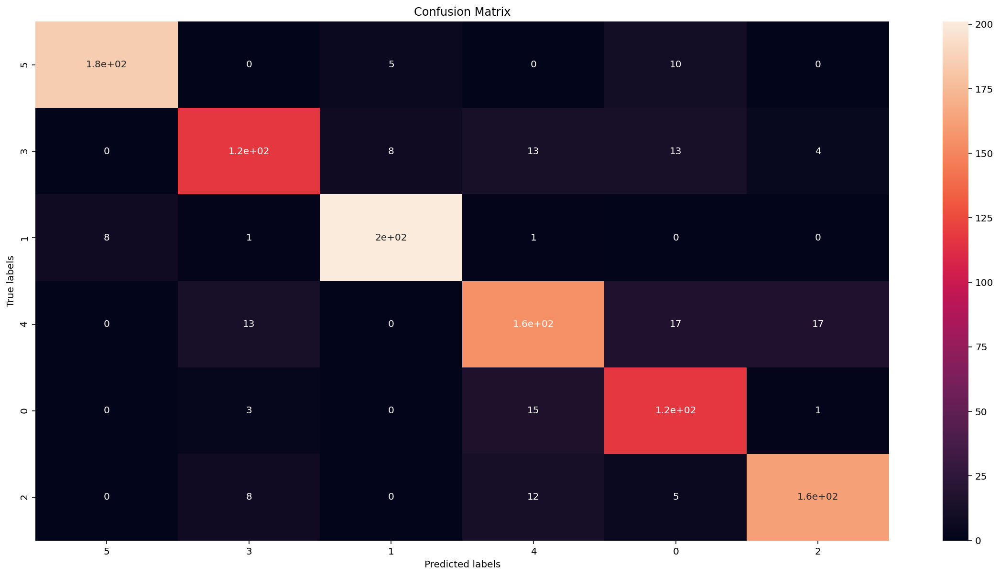

In [304]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cf_matrix, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [305]:
print(classification_report(y_test, y_pred_gini))

              precision    recall  f1-score   support

           0       0.96      0.93      0.94       200
           1       0.82      0.75      0.79       155
           2       0.94      0.95      0.95       211
           3       0.79      0.77      0.78       202
           4       0.72      0.86      0.79       136
           5       0.88      0.87      0.87       187

    accuracy                           0.86      1091
   macro avg       0.85      0.85      0.85      1091
weighted avg       0.86      0.86      0.86      1091



In [306]:
report = classification_report(y_test, y_pred_gini, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'gmm_gini.png')

# ENTROPY

In [307]:
training_loss = []
test_loss = []

def tree_scores(i):
    clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=i, random_state = 42)
    
    
    clf_en.fit(X_train, y_train)
    y_pred_en = clf_en.predict_proba(X_test)
    y_pred_train_en = clf_en.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_en.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_en))

    print('Test set score: {:.4f}'.format(clf_en.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_en))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.3331
Test set score: 0.3630
Max Depth: 2
Training set score: 0.6051
Test set score: 0.5940
Max Depth: 3
Training set score: 0.7587
Test set score: 0.7333
Max Depth: 4
Training set score: 0.8213
Test set score: 0.7910
Max Depth: 5
Training set score: 0.8481
Test set score: 0.8185
Max Depth: 6
Training set score: 0.9090
Test set score: 0.8827
Max Depth: 7
Training set score: 0.9429
Test set score: 0.9038
Max Depth: 8
Training set score: 0.9613
Test set score: 0.9157
Max Depth: 9
Training set score: 0.9765
Test set score: 0.9138
Max Depth: 10
Training set score: 0.9903
Test set score: 0.9203


Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

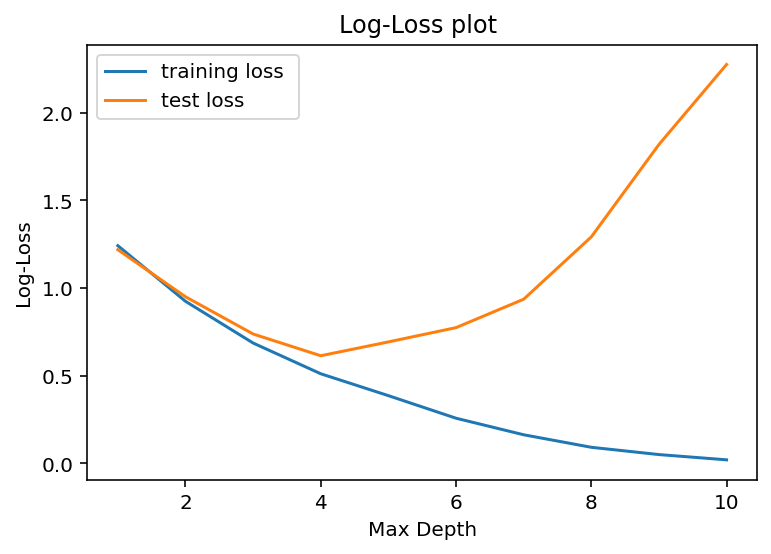

In [308]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [309]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='entropy', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

GridSearchCV(estimator=DecisionTreeClassifier(criterion='entropy',
                                              random_state=42),
             n_jobs=4, param_grid={'max_depth': range(1, 11)})

0.9275306392392964 {'max_depth': 10}


In [310]:
clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=4, random_state = 42)

clf_en.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=4, random_state=42)

In [311]:
y_pred_en = clf_en.predict(X_test)

In [312]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_en.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_en.score(X_test, y_test)))

Training set score: 0.8213
Test set score: 0.7910


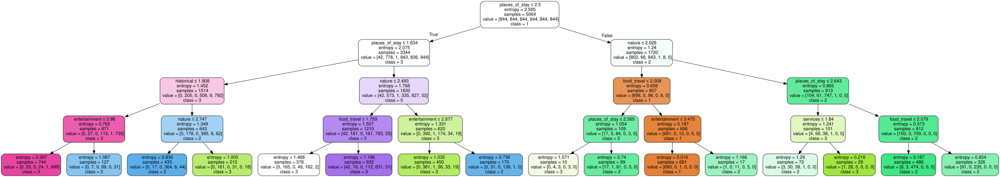

In [313]:
dot_data = tree.export_graphviz(clf_en, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [314]:
cm = confusion_matrix(y_test, y_pred_en)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[158   0  32   0  10   0]
 [  0 124   9   9   4   9]
 [  1   5 205   0   0   0]
 [  0  40   0 120  34   8]
 [  0  32   0   4 100   0]
 [  0  12   0  13   6 156]]


<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '5'),
 Text(1.5, 0, '3'),
 Text(2.5, 0, '1'),
 Text(3.5, 0, '4'),
 Text(4.5, 0, '0'),
 Text(5.5, 0, '2')]

[Text(0, 0.5, '5'),
 Text(0, 1.5, '3'),
 Text(0, 2.5, '1'),
 Text(0, 3.5, '4'),
 Text(0, 4.5, '0'),
 Text(0, 5.5, '2')]

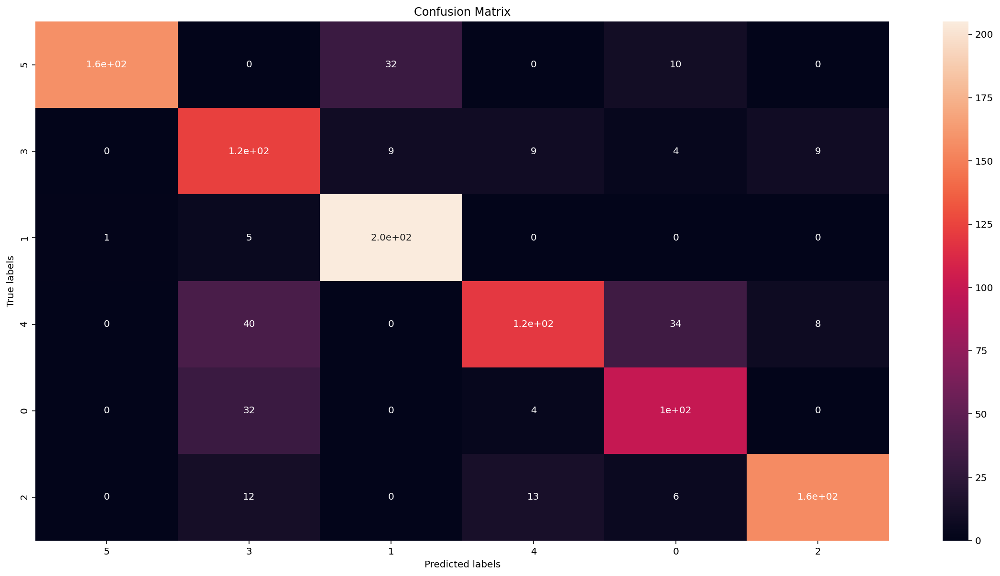

In [315]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [316]:
print(classification_report(y_test, y_pred_en))

              precision    recall  f1-score   support

           0       0.99      0.79      0.88       200
           1       0.58      0.80      0.67       155
           2       0.83      0.97      0.90       211
           3       0.82      0.59      0.69       202
           4       0.65      0.74      0.69       136
           5       0.90      0.83      0.87       187

    accuracy                           0.79      1091
   macro avg       0.80      0.79      0.78      1091
weighted avg       0.81      0.79      0.79      1091



In [317]:
report = classification_report(y_test, y_pred_en, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'gmm_en.png')

# GRADIENT BOOSTING

In [318]:
from sklearn.ensemble import GradientBoostingClassifier

training_loss = []
test_loss = []

def tree_scores(i):
    clf_gb = GradientBoostingClassifier( max_depth=i, random_state = 42)
    
    
    clf_gb.fit(X_train, y_train.values.ravel())
    y_pred_gb = clf_gb.predict_proba(X_test)
    y_pred_train_gb = clf_gb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_gb))

    print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_gb))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.9258
Test set score: 0.9074
Max Depth: 2
Training set score: 0.9729
Test set score: 0.9441
Max Depth: 3
Training set score: 0.9970
Test set score: 0.9569
Max Depth: 4
Training set score: 1.0000
Test set score: 0.9652
Max Depth: 5
Training set score: 1.0000
Test set score: 0.9643
Max Depth: 6
Training set score: 1.0000
Test set score: 0.9688
Max Depth: 7
Training set score: 1.0000
Test set score: 0.9661
Max Depth: 8
Training set score: 1.0000
Test set score: 0.9615
Max Depth: 9
Training set score: 1.0000
Test set score: 0.9633
Max Depth: 10
Training set score: 1.0000
Test set score: 0.9569


Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

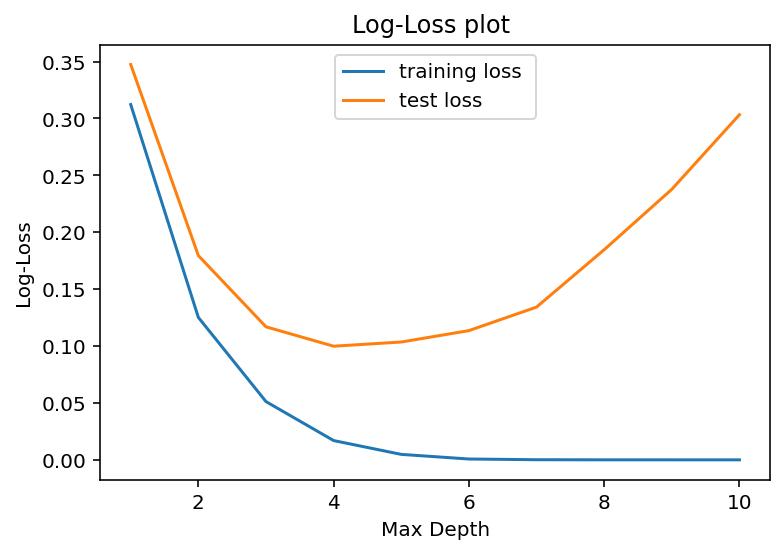

In [319]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [ ]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(GradientBoostingClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

In [ ]:
clf_gb = GradientBoostingClassifier( max_depth=4, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gb, X_train, y_train.values.ravel(), cv=10)))

In [320]:
clf_gb = GradientBoostingClassifier( max_depth=3, random_state = 42)

clf_gb.fit(X_train, y_train.values.ravel())

GradientBoostingClassifier(random_state=42)

In [321]:
y_pred_gb = clf_gb.predict(X_test)

In [322]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))

Training set score: 0.9970
Test set score: 0.9569


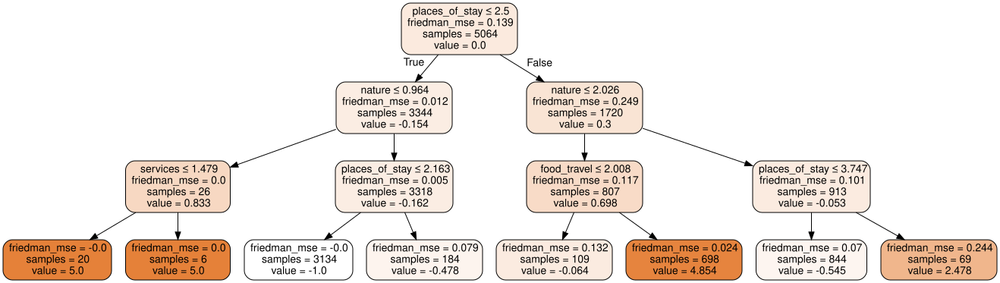

In [324]:
dot_data = tree.export_graphviz(clf_gb.estimators_[0, 0], out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [325]:
cm = confusion_matrix(y_test, y_pred_gb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[196   0   1   0   3   0]
 [  1 143   2   2   5   2]
 [  2   4 205   0   0   0]
 [  0   4   0 189   2   7]
 [  0   0   0   4 132   0]
 [  0   2   0   2   4 179]]


<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '5'),
 Text(1.5, 0, '3'),
 Text(2.5, 0, '1'),
 Text(3.5, 0, '4'),
 Text(4.5, 0, '0'),
 Text(5.5, 0, '2')]

[Text(0, 0.5, '5'),
 Text(0, 1.5, '3'),
 Text(0, 2.5, '1'),
 Text(0, 3.5, '4'),
 Text(0, 4.5, '0'),
 Text(0, 5.5, '2')]

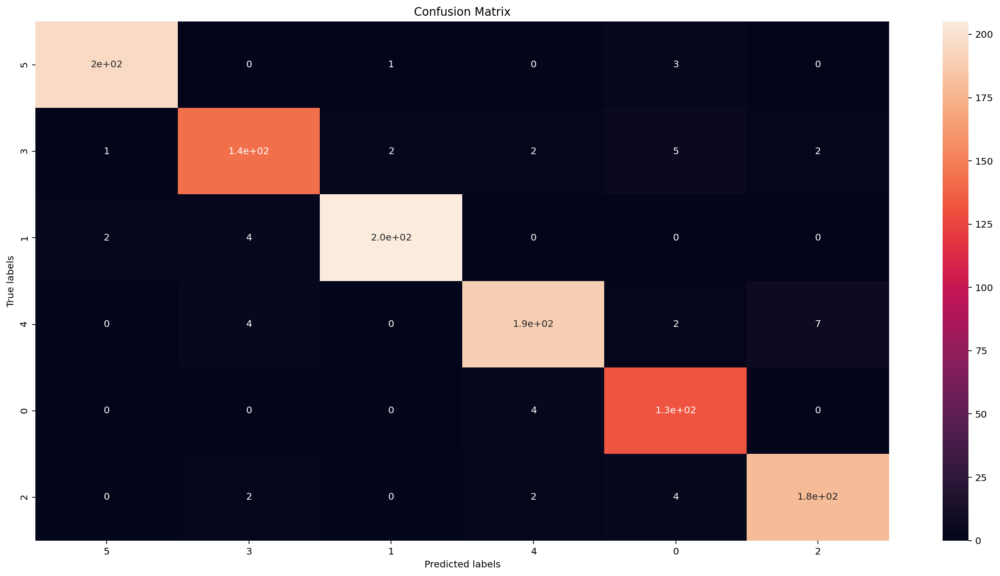

In [326]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [327]:
print(classification_report(y_test, y_pred_gb))

              precision    recall  f1-score   support

           0       0.98      0.98      0.98       200
           1       0.93      0.92      0.93       155
           2       0.99      0.97      0.98       211
           3       0.96      0.94      0.95       202
           4       0.90      0.97      0.94       136
           5       0.95      0.96      0.95       187

    accuracy                           0.96      1091
   macro avg       0.95      0.96      0.95      1091
weighted avg       0.96      0.96      0.96      1091



In [328]:
report = classification_report(y_test, y_pred_gb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'gmm_gb.png')

# XGBOOST

In [329]:
training_loss = []
test_loss = []

def tree_scores(i):
    clf_xgb = xgb.XGBClassifier( max_depth=i, random_state = 42, n_jobs = 4)
    
    
    clf_xgb.fit(X_train, y_train.values.ravel())
    y_pred_xgb = clf_xgb.predict_proba(X_test)
    y_pred_train_xgb = clf_xgb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_xgb))

    print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_xgb))
     
        
for i in range(1,11):
    tree_scores(i)

[22:10:21] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 1
Training set score: 0.9471
Test set score: 0.9230
[22:10:22] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 2
Training set score: 0.9917
Test set score: 0.9624
[22:10:23] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 3
Training set score: 1.0000
Test set score: 0.9707
[22:10:25] WARNING: xgboost/src/learn

Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

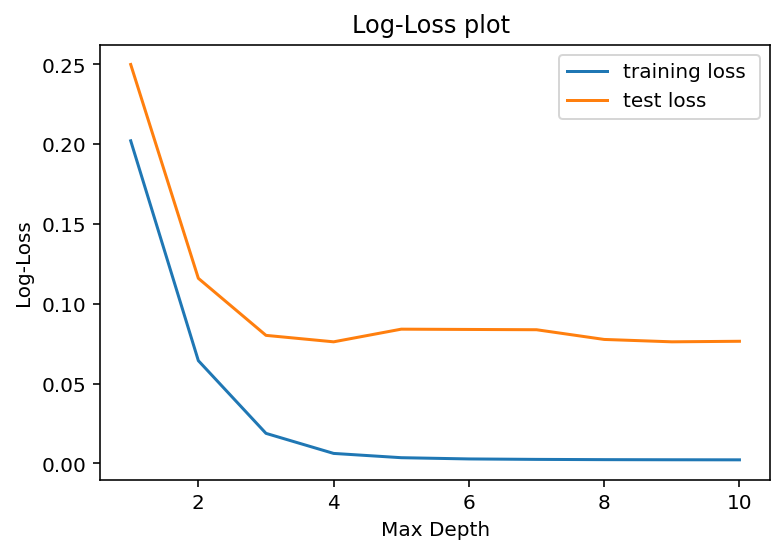

In [330]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [331]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(xgb.XGBClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

[22:13:46] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


GridSearchCV(estimator=XGBClassifier(base_score=None, booster=None,
                                     colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, gamma=None,
                                     gpu_id=None, importance_type='gain',
                                     interaction_constraints=None,
                                     learning_rate=None, max_delta_step=None,
                                     max_depth=10, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     num_parallel_tree=None, random_state=42,
                                     reg_alpha=None, reg_lambda=None,
                                     scale_pos_weight=None, subsample=None,
                                     tree_method=None, validate_parameters=No

0.9695907744772503 {'max_depth': 8}


In [332]:
clf_xgb = xgb.XGBClassifier( max_depth=3, random_state = 42, n_jobs = 4)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_xgb, X_train, y_train.values.ravel(), cv=10)))

[22:14:08] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:14:11] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:14:13] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:14:14] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd li

In [333]:
clf_xgb = xgb.XGBClassifier( max_depth=3, random_state = 42, n_jobs = 4)

clf_xgb.fit(X_train, y_train.values.ravel())

[22:14:27] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=3,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1,
              objective='multi:softprob', random_state=42, reg_alpha=0,
              reg_lambda=1, scale_pos_weight=None, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [334]:
y_pred_xgb = clf_xgb.predict(X_test)

In [335]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))

Training set score: 1.0000
Test set score: 0.9707


<AxesSubplot:>

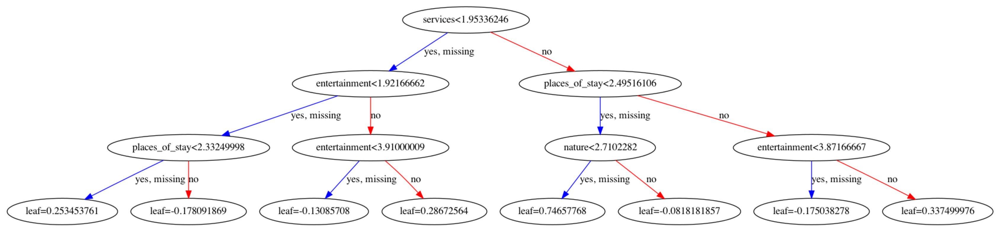

In [336]:
fig, ax = plt.subplots(figsize=(30, 30))
xgb.plot_tree(clf_xgb, num_trees=4, ax=ax)
plt.show()

In [337]:
cm = confusion_matrix(y_test, y_pred_xgb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[195   0   2   0   3   0]
 [  1 145   2   1   3   3]
 [  1   2 208   0   0   0]
 [  0   1   0 195   1   5]
 [  0   0   0   4 132   0]
 [  0   0   0   2   1 184]]


<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '5'),
 Text(1.5, 0, '3'),
 Text(2.5, 0, '1'),
 Text(3.5, 0, '4'),
 Text(4.5, 0, '0'),
 Text(5.5, 0, '2')]

[Text(0, 0.5, '5'),
 Text(0, 1.5, '3'),
 Text(0, 2.5, '1'),
 Text(0, 3.5, '4'),
 Text(0, 4.5, '0'),
 Text(0, 5.5, '2')]

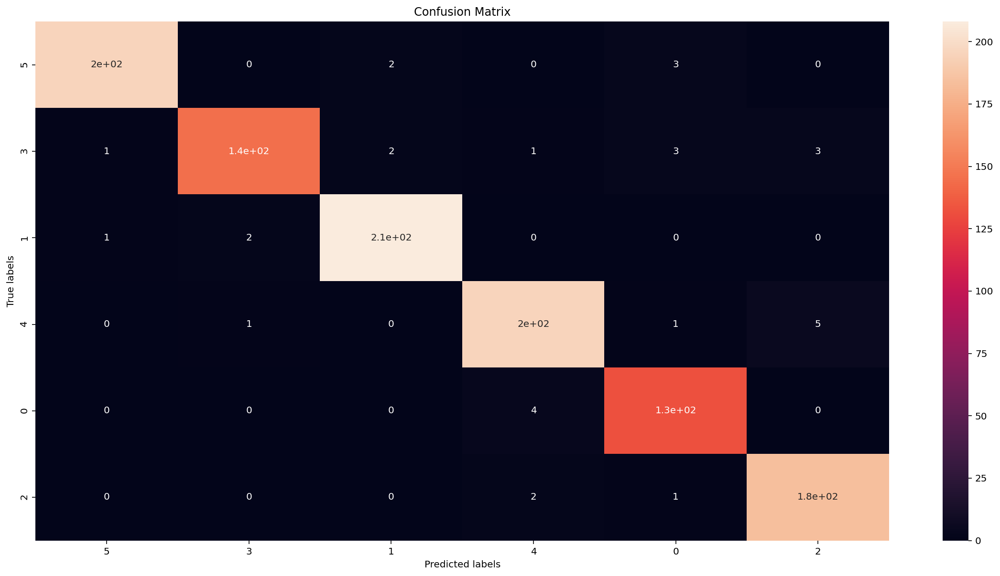

In [338]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [339]:
print(classification_report(y_test, y_pred_xgb))

              precision    recall  f1-score   support

           0       0.99      0.97      0.98       200
           1       0.98      0.94      0.96       155
           2       0.98      0.99      0.98       211
           3       0.97      0.97      0.97       202
           4       0.94      0.97      0.96       136
           5       0.96      0.98      0.97       187

    accuracy                           0.97      1091
   macro avg       0.97      0.97      0.97      1091
weighted avg       0.97      0.97      0.97      1091



In [341]:
report = classification_report(y_test, y_pred_xgb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'gmm_xgb.png')

<h3 id="Kmeans_Dataset">
3.4 KMeans Dataset
<a class="anchor-link" href="https://www.kaggle.com/johnmantios/travel-review-ratings-dataset/edit/run/47115230#Kmeans_Dataset">¶</a>
</h3>

### 3.4.1 Decision Tree

In [343]:
df_kmeans.describe()

,entertainment,food_travel,places_of_stay,historical,nature,services,kmeans
count,5453.000000,5453.000000,5453.000000,5453.000000,5453.000000,5453.000000,5453.000000
mean,2.500826,2.027232,2.222958,2.022007,2.227858,1.330423,0.616725
std,0.722012,0.549363,0.886562,0.585001,0.662444,0.580707,0.486229
min,1.120000,0.721667,0.730000,0.557500,0.576000,0.205000,0.000000
25%,1.963333,1.650000,1.470000,1.647500,1.762000,0.937500,0.000000
50%,2.453333,2.028333,1.885000,1.977500,2.160000,1.245000,1.000000
75%,2.916667,2.433333,3.160000,2.392500,2.656000,1.685000,1.000000
max,5.000000,3.873333,5.000000,4.322500,4.520000,3.937500,1.000000


In [344]:
df_kmeans.drop_duplicates()

,entertainment,food_travel,places_of_stay,historical,nature,services,kmeans
0,3.530000,1.480000,0.850,1.1650,1.926,0.5500,1
1,3.530000,1.481667,0.850,1.1650,1.984,0.5500,1
2,3.530000,1.480000,0.850,1.1650,1.980,0.5500,1
3,3.530000,1.480000,1.100,1.1650,1.922,0.5575,1
5,3.530000,1.481667,0.845,1.1650,1.978,0.5525,1
...,...,...,...,...,...,...,...
5451,1.953333,1.150000,3.145,3.3700,2.888,1.8325,0
5452,1.733333,1.290000,3.135,2.3475,2.794,0.9800,0
5453,1.726667,1.135000,3.040,2.3450,2.798,1.8150,0
5454,1.730000,1.126667,2.555,3.3475,2.802,1.8100,1


In [345]:
for col in df_kmeans.columns:
    print(df_kmeans[col].value_counts())

2.373333    118
2.803333     77
2.893333     60
2.430000     57
2.806667     56
           ... 
1.980000      1
2.596667      1
2.206667      1
3.096667      1
4.386667      1
Name: entertainment, Length: 1024, dtype: int64
2.343333    15
1.715000    13
2.360000    13
1.030000    13
1.033333    12
            ..
3.006667     1
2.038333     1
1.581667     1
1.185000     1
1.583333     1
Name: food_travel, Length: 2012, dtype: int64
1.710    91
1.440    75
1.060    69
2.500    63
1.080    62
         ..
2.060     1
1.670     1
1.215     1
2.110     1
1.340     1
Name: places_of_stay, Length: 694, dtype: int64
1.6025    22
2.2150    22
1.6150    21
2.0800    20
1.6100    19
          ..
1.5750     1
3.7725     1
1.6525     1
2.9300     1
3.7850     1
Name: historical, Length: 1592, dtype: int64
1.832    14
1.972    13
2.364    13
2.014    13
1.680    12
         ..
3.620     1
3.348     1
1.860     1
3.026     1
1.124     1
Name: nature, Length: 1962, dtype: int64
1.2500    64
1.2825    4

In [348]:
X = df_kmeans.drop(['kmeans'], axis = 1)
y = df_kmeans['kmeans']

In [349]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.20, random_state = 42, stratify=y)

In [350]:
print(y_test.value_counts()) #we secured the 20% in the classes represenation

1    673
0    418
Name: kmeans, dtype: int64


In [351]:
sm = SMOTE(random_state = 42)
           
X_train, y_train = sm.fit_sample(X_train, y_train) 

In [352]:
print(y_train.value_counts())

1    2690
0    2690
Name: kmeans, dtype: int64


# GINI CRITERION

In [353]:
from sklearn.metrics import log_loss
from sklearn.tree import DecisionTreeClassifier

training_scores = []
test_scores = []

def tree_scores(i):
    clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=i, random_state = 42)
    
    
    clf_gini.fit(X_train, y_train)
    y_pred_gini = clf_gini.predict_proba(X_test)
    y_pred_train_gini = clf_gini.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))
    training_scores.append(log_loss(y_train, y_pred_train_gini))

    print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))
    test_scores.append(log_loss(y_test, y_pred_gini))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.9846
Test set score: 0.9863
Max Depth: 2
Training set score: 0.9846
Test set score: 0.9863
Max Depth: 3
Training set score: 0.9905
Test set score: 0.9899
Max Depth: 4
Training set score: 0.9933
Test set score: 0.9918
Max Depth: 5
Training set score: 0.9961
Test set score: 0.9936
Max Depth: 6
Training set score: 0.9968
Test set score: 0.9936
Max Depth: 7
Training set score: 0.9983
Test set score: 0.9936
Max Depth: 8
Training set score: 0.9994
Test set score: 0.9936
Max Depth: 9
Training set score: 0.9996
Test set score: 0.9936
Max Depth: 10
Training set score: 1.0000
Test set score: 0.9936


Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

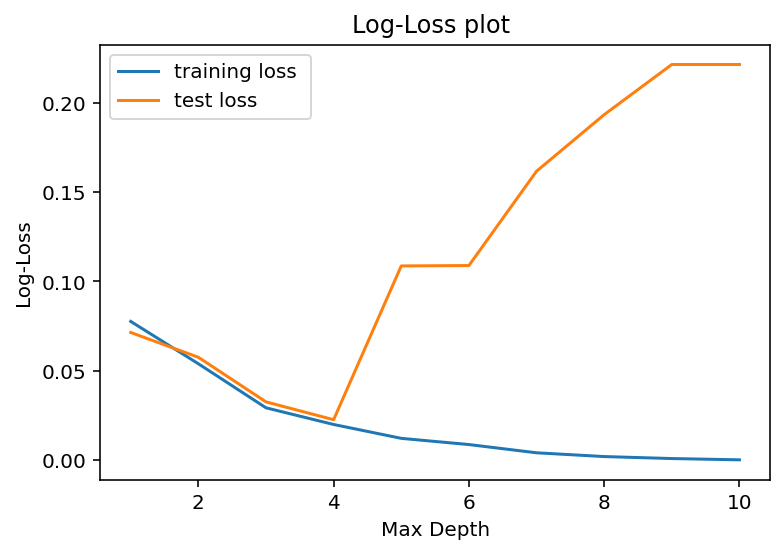

In [354]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_scores, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_scores, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [355]:
from sklearn.model_selection import GridSearchCV

parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='gini', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

GridSearchCV(estimator=DecisionTreeClassifier(random_state=42), n_jobs=4,
             param_grid={'max_depth': range(1, 11)})

0.991635687732342 {'max_depth': 8}


In [356]:
from sklearn.model_selection import cross_val_score

clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=4, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gini, X_train, y_train, cv=10)))

Cross-Validation Score: 0.9895910780669144


In [357]:
clf_gini = DecisionTreeClassifier(criterion='gini', max_depth=4, random_state = 42)

clf_gini.fit(X_train, y_train)

DecisionTreeClassifier(max_depth=4, random_state=42)

In [358]:
y_pred_gini = clf_gini.predict(X_test)

In [359]:
print('Training set score: {:.4f}'.format(clf_gini.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gini.score(X_test, y_test)))

Training set score: 0.9933
Test set score: 0.9918


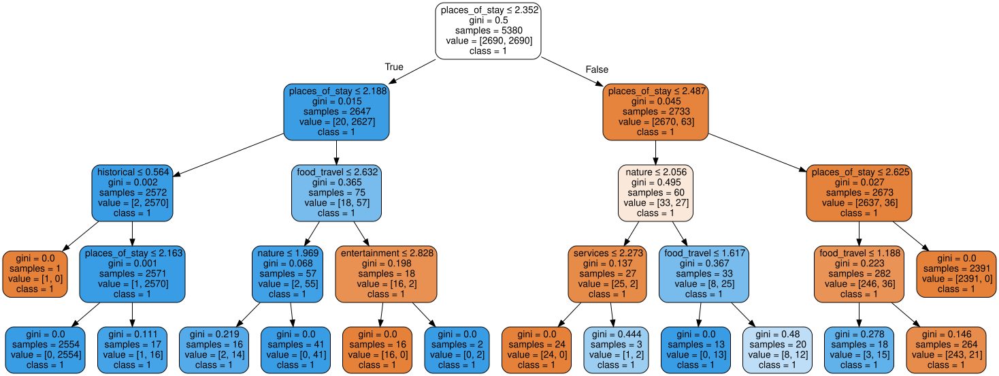

In [360]:
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import graphviz
from sklearn import tree



dot_data = tree.export_graphviz(clf_gini, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [361]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import plot_confusion_matrix

cf_matrix = confusion_matrix(y_test, y_pred_gini)

cf_matrix

array([[414,   4],
       [  5, 668]])

<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '1'), Text(1.5, 0, '0')]

[Text(0, 0.5, '1'), Text(0, 1.5, '0')]

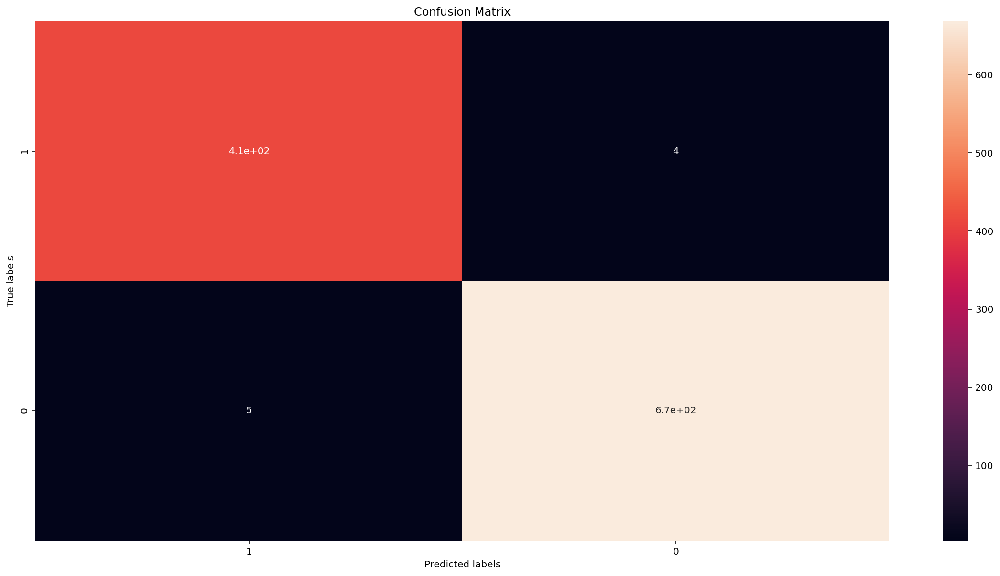

In [362]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cf_matrix, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [363]:
print(classification_report(y_test, y_pred_gini))

              precision    recall  f1-score   support

           0       0.99      0.99      0.99       418
           1       0.99      0.99      0.99       673

    accuracy                           0.99      1091
   macro avg       0.99      0.99      0.99      1091
weighted avg       0.99      0.99      0.99      1091



In [364]:
report = classification_report(y_test, y_pred_gini, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'kmeans_gini.png')

# ENTROPY

In [365]:
training_loss = []
test_loss = []

def tree_scores(i):
    clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=i, random_state = 42)
    
    
    clf_en.fit(X_train, y_train)
    y_pred_en = clf_en.predict_proba(X_test)
    y_pred_train_en = clf_en.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_en.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_en))

    print('Test set score: {:.4f}'.format(clf_en.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_en))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.9846
Test set score: 0.9863
Max Depth: 2
Training set score: 0.9846
Test set score: 0.9863
Max Depth: 3
Training set score: 0.9872
Test set score: 0.9908
Max Depth: 4
Training set score: 0.9931
Test set score: 0.9918
Max Depth: 5
Training set score: 0.9941
Test set score: 0.9918
Max Depth: 6
Training set score: 0.9967
Test set score: 0.9927
Max Depth: 7
Training set score: 0.9976
Test set score: 0.9945
Max Depth: 8
Training set score: 0.9991
Test set score: 0.9945
Max Depth: 9
Training set score: 0.9998
Test set score: 0.9936
Max Depth: 10
Training set score: 1.0000
Test set score: 0.9908


Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

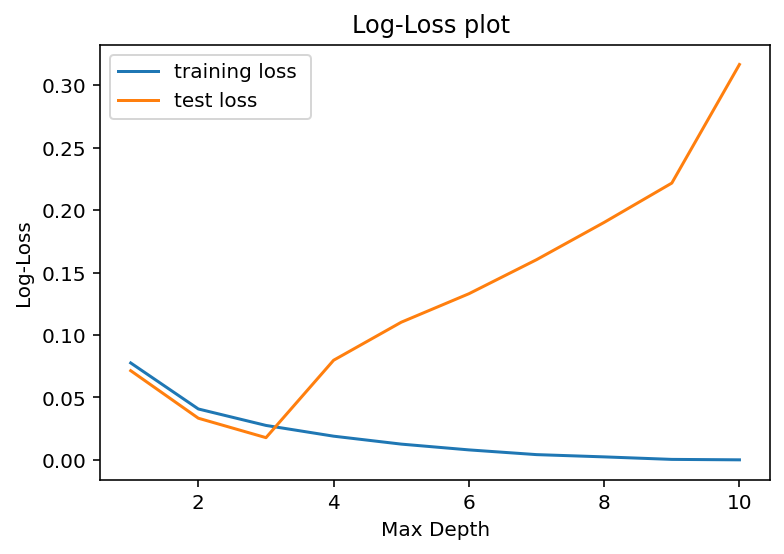

In [366]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [367]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(DecisionTreeClassifier(criterion='entropy', random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train)
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

GridSearchCV(estimator=DecisionTreeClassifier(criterion='entropy',
                                              random_state=42),
             n_jobs=4, param_grid={'max_depth': range(1, 11)})

0.9925650557620818 {'max_depth': 9}


In [368]:
clf_en = DecisionTreeClassifier(criterion='entropy', max_depth=3, random_state = 42)

clf_en.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy', max_depth=3, random_state=42)

In [369]:
y_pred_en = clf_en.predict(X_test)

In [370]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_en.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_en.score(X_test, y_test)))

Training set score: 0.9872
Test set score: 0.9908


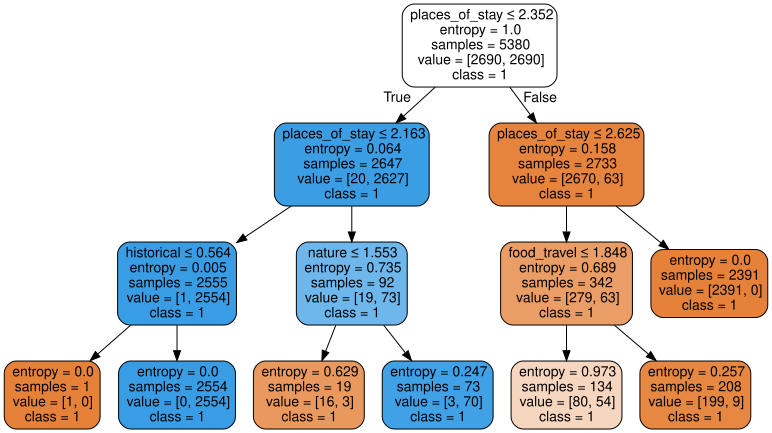

In [371]:
dot_data = tree.export_graphviz(clf_en, out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [372]:
cm = confusion_matrix(y_test, y_pred_en)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[418   0]
 [ 10 663]]


<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '1'), Text(1.5, 0, '0')]

[Text(0, 0.5, '1'), Text(0, 1.5, '0')]

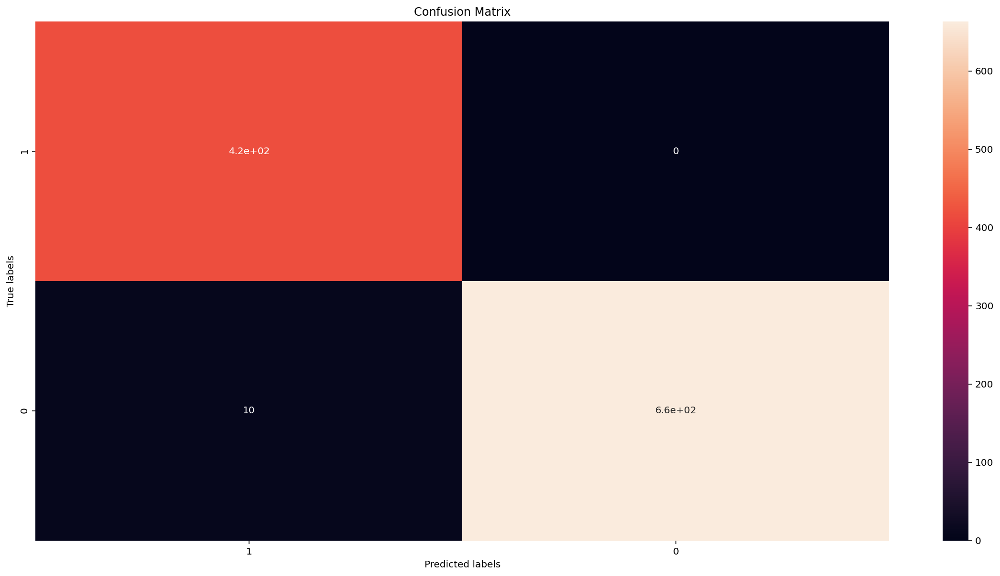

In [373]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(y_test.unique())
ax.yaxis.set_ticklabels(y_test.unique())

In [374]:
print(classification_report(y_test, y_pred_en))

              precision    recall  f1-score   support

           0       0.98      1.00      0.99       418
           1       1.00      0.99      0.99       673

    accuracy                           0.99      1091
   macro avg       0.99      0.99      0.99      1091
weighted avg       0.99      0.99      0.99      1091



In [375]:
report = classification_report(y_test, y_pred_en, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'kmeans_en.png')

# GRADIENT BOOSTING

In [376]:
from sklearn.ensemble import GradientBoostingClassifier

training_loss = []
test_loss = []

def tree_scores(i):
    clf_gb = GradientBoostingClassifier( max_depth=i, random_state = 42)
    
    
    clf_gb.fit(X_train, y_train.values.ravel())
    y_pred_gb = clf_gb.predict_proba(X_test)
    y_pred_train_gb = clf_gb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_gb))

    print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_gb))
     
        
for i in range(1,11):
    tree_scores(i)

Max Depth: 1
Training set score: 0.9920
Test set score: 0.9908
Max Depth: 2
Training set score: 0.9978
Test set score: 0.9936
Max Depth: 3
Training set score: 0.9996
Test set score: 0.9954
Max Depth: 4
Training set score: 1.0000
Test set score: 0.9945
Max Depth: 5
Training set score: 1.0000
Test set score: 0.9936
Max Depth: 6
Training set score: 1.0000
Test set score: 0.9945
Max Depth: 7
Training set score: 1.0000
Test set score: 0.9927
Max Depth: 8
Training set score: 1.0000
Test set score: 0.9918
Max Depth: 9
Training set score: 1.0000
Test set score: 0.9945
Max Depth: 10
Training set score: 1.0000
Test set score: 0.9954


Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

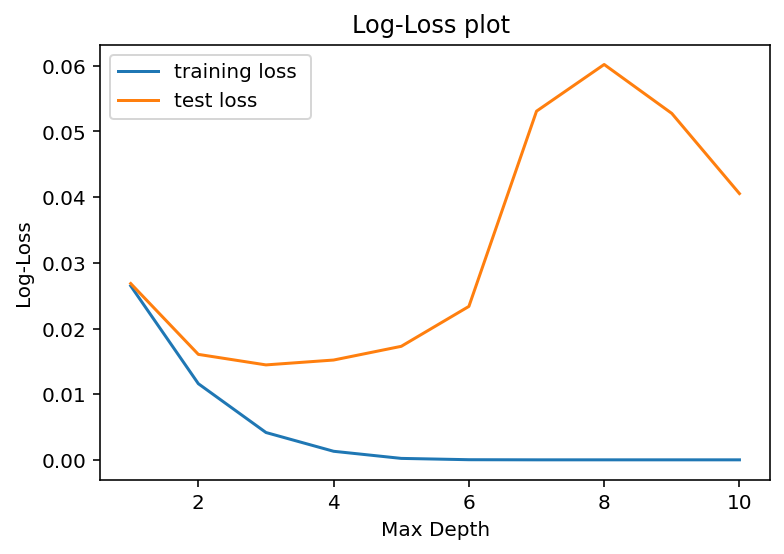

In [377]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [378]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(GradientBoostingClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

GridSearchCV(estimator=GradientBoostingClassifier(max_depth=10,
                                                  random_state=42),
             n_jobs=4, param_grid={'max_depth': range(1, 11)})

0.9946096654275094 {'max_depth': 4}


In [379]:
clf_gb = GradientBoostingClassifier( max_depth=3, random_state = 42)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_gb, X_train, y_train.values.ravel(), cv=10)))

Cross-Validation Score: 0.9946096654275092


In [380]:
clf_gb = GradientBoostingClassifier( max_depth=3, random_state = 42)

clf_gb.fit(X_train, y_train.values.ravel())

GradientBoostingClassifier(random_state=42)

In [381]:
y_pred_gb = clf_gb.predict(X_test)

In [382]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_gb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_gb.score(X_test, y_test)))

Training set score: 0.9996
Test set score: 0.9954


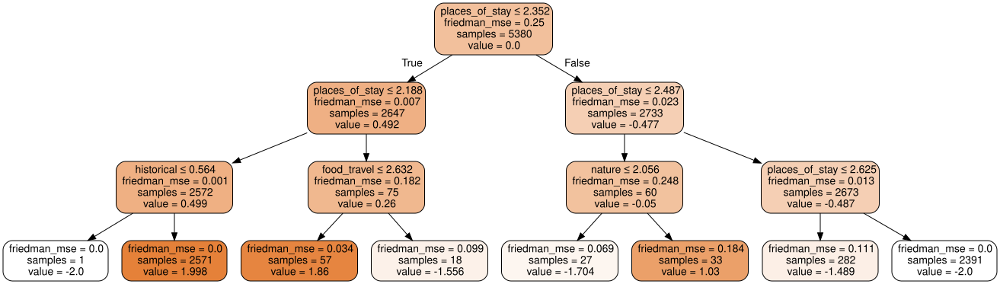

In [383]:
dot_data = tree.export_graphviz(clf_gb.estimators_[0, 0], out_file=None, 
                              feature_names=X_train.columns,  
                              class_names=y_train.apply(str),  
                              filled=True, rounded=True,  
                              special_characters=True)

graph = graphviz.Source(dot_data) 

graph 

In [384]:
cm = confusion_matrix(y_test, y_pred_gb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[416   2]
 [  3 670]]


<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '1'), Text(1.5, 0, '0')]

[Text(0, 0.5, '1'), Text(0, 1.5, '0')]

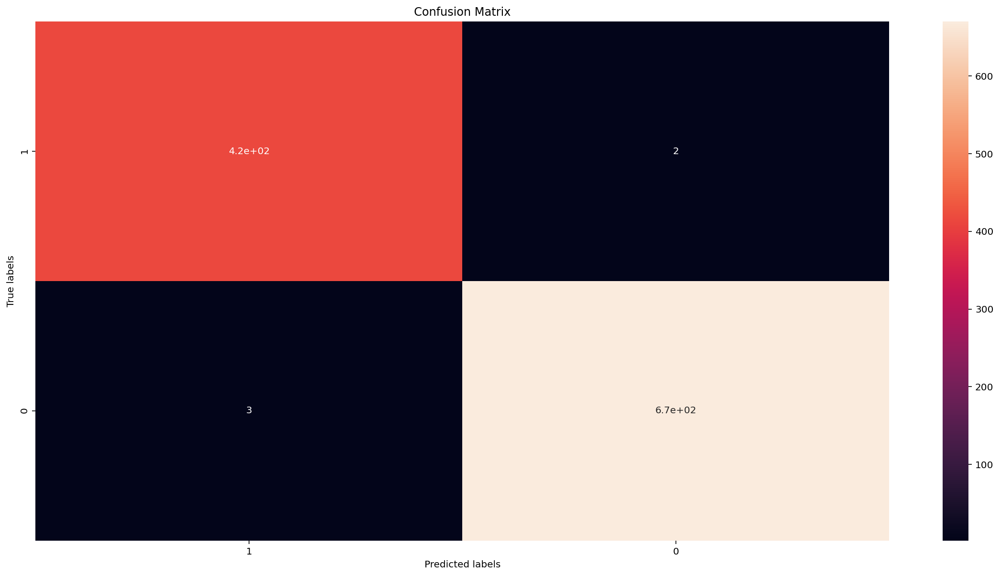

In [385]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [386]:
print(classification_report(y_test, y_pred_gb))

              precision    recall  f1-score   support

           0       0.99      1.00      0.99       418
           1       1.00      1.00      1.00       673

    accuracy                           1.00      1091
   macro avg       0.99      1.00      1.00      1091
weighted avg       1.00      1.00      1.00      1091



In [387]:
report = classification_report(y_test, y_pred_gb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'kmeans_gb.png')

# XGBOOST

In [388]:
training_loss = []
test_loss = []

def tree_scores(i):
    clf_xgb = xgb.XGBClassifier( max_depth=i, random_state = 42, n_jobs = 4)
    
    
    clf_xgb.fit(X_train, y_train.values.ravel())
    y_pred_xgb = clf_xgb.predict_proba(X_test)
    y_pred_train_xgb = clf_xgb.predict_proba(X_train)
    
     
    print('Max Depth:' ,i)    
    print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))
    training_loss.append(log_loss(y_train, y_pred_train_xgb))

    print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))
    test_loss.append(log_loss(y_test, y_pred_xgb))
     
        
for i in range(1,11):
    tree_scores(i)

[22:55:38] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 1
Training set score: 0.9981
Test set score: 0.9945
[22:55:38] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 2
Training set score: 1.0000
Test set score: 0.9954
[22:55:39] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
Max Depth: 3
Training set score: 1.0000
Test set score: 0.9963
[22:55:39] WARNING: xgboost/src/learner.

Text(0.5, 0, 'Max Depth')

Text(0, 0.5, 'Log-Loss')

Text(0.5, 1.0, 'Log-Loss plot ')

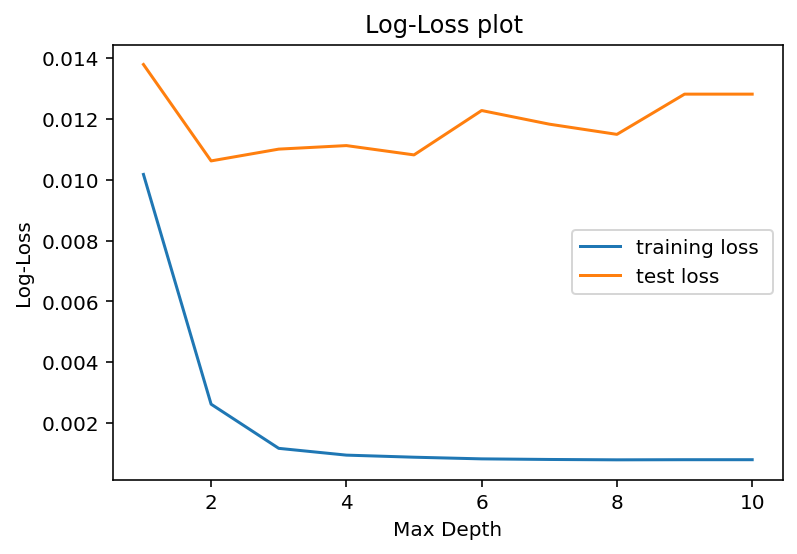

In [389]:
y = [1,2,3,4,5,6,7,8,9,10]

# plotting the line 1 points 
plt.plot(y, training_loss, label = "training loss ")

# plotting the line 2 points 
plt.plot(y, test_loss, label = "test loss ")
plt.xlabel('Max Depth')
# Set the y axis label of the current axis.
plt.ylabel('Log-Loss')
# Set a title of the current axes.
plt.title('Log-Loss plot ')
# show a legend on the plot
plt.legend()
# Display a figure.
plt.show()

In [390]:
parameters = {'max_depth':range(1,11)}
clf = GridSearchCV(xgb.XGBClassifier( max_depth=i, random_state = 42),  parameters, n_jobs=4)
clf.fit(X=X_train, y=y_train.values.ravel())
tree_model = clf.best_estimator_
print (clf.best_score_, clf.best_params_) 

[22:56:10] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


GridSearchCV(estimator=XGBClassifier(base_score=None, booster=None,
                                     colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None, gamma=None,
                                     gpu_id=None, importance_type='gain',
                                     interaction_constraints=None,
                                     learning_rate=None, max_delta_step=None,
                                     max_depth=10, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     num_parallel_tree=None, random_state=42,
                                     reg_alpha=None, reg_lambda=None,
                                     scale_pos_weight=None, subsample=None,
                                     tree_method=None, validate_parameters=No

0.996096654275093 {'max_depth': 2}


In [332]:
clf_xgb = xgb.XGBClassifier( max_depth=3, random_state = 42, n_jobs = 4)

print('Cross-Validation Score:',np.mean(cross_val_score(clf_xgb, X_train, y_train.values.ravel(), cv=10)))

[22:14:08] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:14:11] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:14:13] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd like to restore the old behavior.
[22:14:14] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'multi:softprob' was changed from 'merror' to 'mlogloss'. Explicitly set eval_metric if you'd li

In [391]:
clf_xgb = xgb.XGBClassifier( max_depth=2, random_state = 42, n_jobs = 4)

clf_xgb.fit(X_train, y_train.values.ravel())

[22:56:10] WARNING: xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.300000012, max_delta_step=0, max_depth=2,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=100, n_jobs=4, num_parallel_tree=1, random_state=42,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [392]:
y_pred_xgb = clf_xgb.predict(X_test)

In [393]:
# print the scores on training and test set

print('Training set score: {:.4f}'.format(clf_xgb.score(X_train, y_train)))

print('Test set score: {:.4f}'.format(clf_xgb.score(X_test, y_test)))

Training set score: 1.0000
Test set score: 0.9954


<AxesSubplot:>

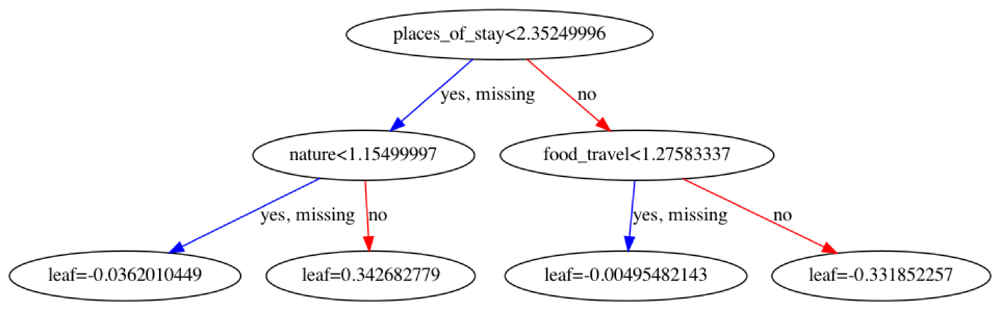

In [394]:
fig, ax = plt.subplots(figsize=(30, 30))
xgb.plot_tree(clf_xgb, num_trees=4, ax=ax)
plt.show()

In [395]:
cm = confusion_matrix(y_test, y_pred_xgb)

print('Confusion matrix\n\n', cm)

Confusion matrix

 [[415   3]
 [  2 671]]


<Figure size 1440x720 with 0 Axes>

<AxesSubplot:>

Text(0.5, 69.0, 'Predicted labels')

Text(159.0, 0.5, 'True labels')

Text(0.5, 1.0, 'Confusion Matrix')

[Text(0.5, 0, '1'), Text(1.5, 0, '0')]

[Text(0, 0.5, '1'), Text(0, 1.5, '0')]

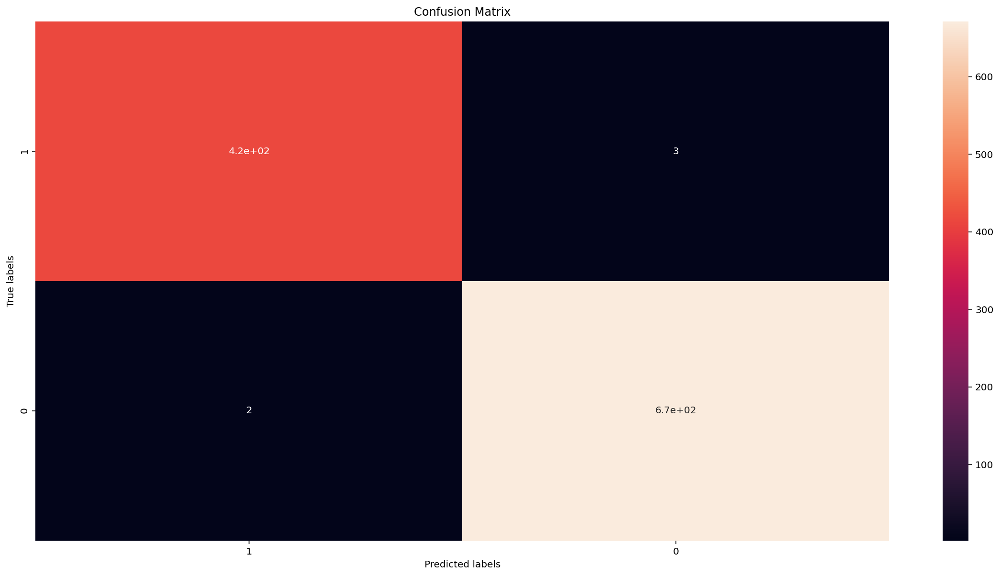

In [396]:
plt.figure(figsize=(20,10))
ax= plt.subplot()
sns.heatmap(cm, annot=True, ax = ax)  #annot=True to annotate cells

# labels, title and ticks
ax.set_xlabel('Predicted labels')
ax.set_ylabel('True labels')
ax.set_title('Confusion Matrix')
ax.xaxis.set_ticklabels(pd.unique(y_test.values.ravel()))
ax.yaxis.set_ticklabels(pd.unique(y_test.values.ravel()))

In [397]:
print(classification_report(y_test, y_pred_xgb))

              precision    recall  f1-score   support

           0       1.00      0.99      0.99       418
           1       1.00      1.00      1.00       673

    accuracy                           1.00      1091
   macro avg       1.00      0.99      1.00      1091
weighted avg       1.00      1.00      1.00      1091



In [398]:
report = classification_report(y_test, y_pred_xgb, output_dict=True)

df_report = pd.DataFrame(report).transpose()

dfi.export(df_report, 'kmeans_xgb.png')